# Import libraries

In [269]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
# declaring global font size for plots:
plt.figure()
plt.rcParams.update({'font.size':14})
plt.rc('legend',fontsize=14)

<Figure size 432x288 with 0 Axes>

# Reading Data

In [270]:
# reading the CSV dataset fil
df = pd.read_csv('../datasets/no1_aggregated/no1_2020_to_2022_aggregated.csv', index_col=0)

# 5 first rows of the dataset
df.head()

,end MTU (UTC),Day-ahead Price [EUR/MWh] BZN|NO1,Day-ahead Price [EUR/MWh] BZN|NO2,Day-ahead Price [EUR/MWh] BZN|NO3,Day-ahead Price [EUR/MWh] BZN|NO5,Day-ahead Price [EUR/MWh] BZN|SE3,Actual Total Load [MW] - BZN|NO1,Actual Total Load [MW] - BZN|NO2,Actual Total Load [MW] - BZN|NO3,Actual Total Load [MW] - BZN|NO5,...,CBF BZN|NO1 > BZN|NO3 [MW],CBF BZN|NO5 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|NO5 [MW],CBF BZN|SE3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|SE3 [MW],Stored Energy Value Water Reservoirs and Hydro Storage Plants [MWh] - BZN|NO1,Stored Energy Value Water Reservoirs and Hydro Storage Plants [MWh] - BZN|NO2,Stored Energy Value Water Reservoirs and Hydro Storage Plants [MWh] - BZN|NO3,Stored Energy Value Water Reservoirs and Hydro Storage Plants [MWh] - BZN|NO5,Stored Energy Value Water Reservoirs and Hydro Storage Plants [MWh] - BZN|SE3
start MTU (UTC),,,,,,,,,,,,,,,,,,,,,
2020-01-01 00:00:00,2020-01-01 01:00:00,31.77,31.77,28.45,31.77,28.45,4333.0,4139.0,3016.0,1950.0,...,0.0,1449.0,0.0,391,0,4012000.0,24273000.0,5588000.0,11211000.0,2220000.0
2020-01-01 01:00:00,2020-01-01 02:00:00,31.57,31.57,27.90,31.57,27.90,4250.0,4114.0,2945.0,1926.0,...,0.0,1283.0,0.0,348,0,4012000.0,24273000.0,5588000.0,11211000.0,2220000.0
2020-01-01 02:00:00,2020-01-01 03:00:00,31.28,31.28,27.52,31.28,27.52,4167.0,4030.0,3032.0,1913.0,...,6.0,962.0,0.0,500,0,4012000.0,24273000.0,5588000.0,11211000.0,2220000.0
2020-01-01 03:00:00,2020-01-01 04:00:00,30.72,30.72,27.54,30.72,27.54,4145.0,4032.0,2988.0,1894.0,...,6.0,767.0,0.0,610,0,4012000.0,24273000.0,5588000.0,11211000.0,2220000.0
2020-01-01 04:00:00,2020-01-01 05:00:00,30.27,30.27,26.55,30.27,26.55,4222.0,4032.0,2848.0,1901.0,...,22.0,642.0,0.0,909,0,4012000.0,24273000.0,5588000.0,11211000.0,2220000.0


57 columns in total and there are 26304 records as expected. all the features are numerical except end MTU (UTC).

In [271]:
df.shape

(26304, 57)

In [272]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 26304 entries, 2020-01-01 00:00:00 to 2022-12-31 23:00:00
Data columns (total 57 columns):
 #   Column                                                                         Non-Null Count  Dtype  
---  ------                                                                         --------------  -----  
 0   end MTU (UTC)                                                                  26304 non-null  object 
 1   Day-ahead Price [EUR/MWh] BZN|NO1                                              26304 non-null  float64
 2   Day-ahead Price [EUR/MWh] BZN|NO2                                              26304 non-null  float64
 3   Day-ahead Price [EUR/MWh] BZN|NO3                                              26304 non-null  float64
 4   Day-ahead Price [EUR/MWh] BZN|NO5                                              26304 non-null  float64
 5   Day-ahead Price [EUR/MWh] BZN|SE3                                              26304 non-null  float64


In [273]:
# Renaming column names to make it easier to plot and read the graphs
df = df.rename(columns={
    'Stored Energy Value Water Reservoirs and Hydro Storage Plants [MWh] - BZN|NO1':
        'Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1' ,
    'Stored Energy Value Water Reservoirs and Hydro Storage Plants [MWh] - BZN|NO2':
        'Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2',
    'Stored Energy Value Water Reservoirs and Hydro Storage Plants [MWh] - BZN|NO3':
        'Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3',
    'Stored Energy Value Water Reservoirs and Hydro Storage Plants [MWh] - BZN|NO5':
        'Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO5',
    'Stored Energy Value Water Reservoirs and Hydro Storage Plants [MWh] - BZN|SE3':
        'Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3'}
)

Removing the 'end MTU' column from the dataframe. We know each row is an hourly collected observation. There is no need to define the start and end time , only start time is necessary.

In [274]:
df.drop('end MTU (UTC)', inplace =True,  axis = 1)

In [275]:
 # Target/dependent column and input/independent columns
df_target_column = df['Day-ahead Price [EUR/MWh] BZN|NO1']

df_without_target = df.drop('Day-ahead Price [EUR/MWh] BZN|NO1', axis = 1)


### Indexing and reindexing , convert the time index to Datetime type from Object type.

In [276]:
# Separate the Datetime column (index), to convert it from Object to Datetime
df = df.reset_index()
# we kan see the 'start MTU (UTC)' as first column, having datatype object
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26304 entries, 0 to 26303
Data columns (total 57 columns):
 #   Column                                                   Non-Null Count  Dtype  
---  ------                                                   --------------  -----  
 0   start MTU (UTC)                                          26304 non-null  object 
 1   Day-ahead Price [EUR/MWh] BZN|NO1                        26304 non-null  float64
 2   Day-ahead Price [EUR/MWh] BZN|NO2                        26304 non-null  float64
 3   Day-ahead Price [EUR/MWh] BZN|NO3                        26304 non-null  float64
 4   Day-ahead Price [EUR/MWh] BZN|NO5                        26304 non-null  float64
 5   Day-ahead Price [EUR/MWh] BZN|SE3                        26304 non-null  float64
 6   Actual Total Load [MW] - BZN|NO1                         26303 non-null  float64
 7   Actual Total Load [MW] - BZN|NO2                         26303 non-null  float64
 8   Actual Total Load [MW] - B

In [277]:
## Start MTU (UTC) is converted and using set_index() we want to set it as the index as it was before.
df['start MTU (UTC)'] = pd.to_datetime(df['start MTU (UTC)'])

# set 'start MTU (UTC)' as the index
df = df.set_index('start MTU (UTC)', drop = True)

df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 26304 entries, 2020-01-01 00:00:00 to 2022-12-31 23:00:00
Data columns (total 56 columns):
 #   Column                                                   Non-Null Count  Dtype  
---  ------                                                   --------------  -----  
 0   Day-ahead Price [EUR/MWh] BZN|NO1                        26304 non-null  float64
 1   Day-ahead Price [EUR/MWh] BZN|NO2                        26304 non-null  float64
 2   Day-ahead Price [EUR/MWh] BZN|NO3                        26304 non-null  float64
 3   Day-ahead Price [EUR/MWh] BZN|NO5                        26304 non-null  float64
 4   Day-ahead Price [EUR/MWh] BZN|SE3                        26304 non-null  float64
 5   Actual Total Load [MW] - BZN|NO1                         26303 non-null  float64
 6   Actual Total Load [MW] - BZN|NO2                         26303 non-null  float64
 7   Actual Total Load [MW] - BZN|NO3                         26303 non-null  floa

# Exploratory data analysis
EDA is quite iterative , we often had to redo parts of analysis after discovering some important information. Our EDA goals are achieved after following steps :
- First EDA on raw data
- Frst pass of preprocessing and feature selection. We shall drop useless(low variance) features after first EDA.
- feature engineering and trying to create new features based on existing ones. For example, using combinations
of predictors can sometimes be more effective than using the individual values:
the ratio of two predictors may be more effective than using two independent. (M. Kuhn and K. Johnson, Applied Predictive Modeling, DOI 10.1007/978-1-4614-6849-3 3)

- Define dataset as 5 categories with multiple features.
- Again EDA for each of categories,
- Final preprocessing if needed, and then a quick analysis to make sure everything is okay.

 EDA for this dataset has the following structure:
1. **Structure Investigation** : Shape of dataset , features datatype, number of unique sample for each feature
2. **Quality Investigation** : Duplicate, missing , outliers and unwanted values
3. **Content Investigation** : Feature distribution. Pair-plotting, Feature correlation
4. **Creating 4 dataframes/Categories** :
>Four dataframes from 56 features shall be created to study and analyse our dataset as categories.
> Then for each category conduct
 >>EDA (trend investigation and feature distribution )
 > feature selection
  > feature engineering
  > other preprocessing techniques
5. **Analyse NO1 Categories** for all four main categories in NO1 bidding zone:
> Correlation between all 4 categories for NO1
> Plotting the Total load, Total Import , Total export, day-ahead price and Total Generation NO1.
6. Splitting the dataset
7. Handling all Outliers after splitting dataset into train and test parts.

It is a good solution to analyse all 56 columns as 4 main categories;

Price [EUR/MWh]:
> Day-ahead Price for NO1, NO2, NO3, NO5, SE3

Total Load [MW] :
> Actual Total Load for NO1, NO2, NO3, NO5, SE3

Total Generation per unit type [MW]:
>Fossil Gas
>Nuclear (SE3)Waste (NO1,NO2,NO3,NO5)
>Wind Onshore (NO2,NO3,NO5,SE3)
         Hydro Pumped Storage (NO2,NO3,NO5)
         Hydro Run-of-river and poundage (NO1,NO2,NO3,NO5)
         Other (NO1,NO2,NO3,NO5,SE3)
         Other renewable (NO3)
         Hydro Water Reservoir ( NO1, NO2, NO3, NO5, SE3)
         Total electricity generation NO1 (Created Feature)
         Total electricity generation NO2 (Created Feature)
         Total electricity generation NO3 (Created Feature)
         Total electricity generation NO5 (Created Feature)
         Total electricity generation SE3 (Created Feature)


Import and export [MW] :
> Import and export between NO1 and NO2,NO3,NO5,SE3.
> Total imports to NO1 (Created Feature)
> Total exports from NO1 (Created Feature)

## 1. Structure Investigation

In [278]:
# Our dataset is containing 26304 records and 56 features
df.shape

(26304, 56)

In [279]:
# Count number of data types in the dataset, all features are numerical
pd.value_counts(df.dtypes)

float64    53
int64       3
dtype: int64

#### 1.1 Describe()

Using .describe () will help us find big anomalies and get a feeling for distribution of each feature.

- First thing to highlight is that min value for day-ahead prices is negative (-1,97 EUR)
- Another interesting fact is that electricity is almost 300 % cheaper in NO3 compared to other bidding zones. Looking at mean values : NO3=30 EUR , NO1 =92 EUR ,NO2 =98 EUR, NO5 =91 EUR, SE3 =72 EUR.
- 75 % of prices in NO1 is higher than the mean value for prices in NO1. This indicates seasons/timeperiod very high electricity prices.

For further investigation it is easier to look at each feature as a part of a category for example price, import&export, load , generation and water reservoir categories. This part is done after a analysing and studying the dataset as a whole. (After Content Investigation)

In [280]:
df.describe()

,Day-ahead Price [EUR/MWh] BZN|NO1,Day-ahead Price [EUR/MWh] BZN|NO2,Day-ahead Price [EUR/MWh] BZN|NO3,Day-ahead Price [EUR/MWh] BZN|NO5,Day-ahead Price [EUR/MWh] BZN|SE3,Actual Total Load [MW] - BZN|NO1,Actual Total Load [MW] - BZN|NO2,Actual Total Load [MW] - BZN|NO3,Actual Total Load [MW] - BZN|NO5,Actual Total Load [MW] - BZN|SE3,...,CBF BZN|NO1 > BZN|NO3 [MW],CBF BZN|NO5 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|NO5 [MW],CBF BZN|SE3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|SE3 [MW],Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO5,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3
count,26304.000000,26304.000000,26304.000000,26304.000000,26304.000000,26303.000000,26303.000000,26303.000000,26303.000000,26304.000000,...,26273.000000,26273.000000,26273.000000,26304.000000,26304.000000,2.630400e+04,2.630400e+04,2.630400e+04,2.630400e+04,2.630400e+04
mean,92.089895,98.477096,30.802730,91.868445,72.083614,3943.992891,4179.527354,3137.688020,1901.222028,9771.786915,...,12.051726,1398.770753,12.165836,341.181531,454.188412,3.579091e+06,2.073493e+07,5.731948e+06,9.658894e+06,1.716409e+06
std,102.673358,114.521343,44.767859,102.347340,93.332389,1259.769412,748.668751,485.748914,329.930577,2129.143862,...,39.269949,798.985462,73.549470,497.663086,569.062045,1.582598e+06,6.634143e+06,2.070706e+06,4.128414e+06,3.500652e+05
min,-1.970000,-1.970000,-2.080000,-0.090000,-2.080000,1446.000000,1595.000000,1751.000000,1036.000000,4778.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,4.853340e+05,6.334677e+06,1.691000e+06,1.624537e+06,8.330000e+05
25%,12.530000,12.537500,8.090000,12.617500,16.780000,2922.000000,3574.000000,2748.000000,1647.000000,8110.000000,...,0.000000,827.000000,0.000000,0.000000,0.000000,2.165300e+06,1.671733e+07,4.008874e+06,6.311281e+06,1.546000e+06
50%,54.950000,57.530000,17.625000,54.850000,39.425000,3755.000000,4070.000000,3097.000000,1847.000000,9504.500000,...,0.000000,1402.000000,0.000000,0.000000,67.000000,4.014420e+06,2.026900e+07,6.248826e+06,1.016200e+07,1.733000e+06
75%,140.860000,143.380000,39.980000,140.735000,86.072500,4856.000000,4719.000000,3499.000000,2137.000000,11267.000000,...,0.000000,1935.000000,0.000000,591.000000,895.000000,4.797228e+06,2.427300e+07,7.487797e+06,1.242700e+07,2.019000e+06
max,799.970000,844.000000,590.000000,799.970000,799.970000,7919.000000,7072.000000,5694.000000,4326.000000,16744.000000,...,672.000000,3477.000000,1052.000000,2520.000000,2325.000000,5.919000e+06,3.338800e+07,8.737000e+06,1.645900e+07,2.245000e+06


There are 11 prices equal or below zero EUR, Negative prices occur when supply offered at negative prices is greater than demand. Negative prices are a signal to either increase demand or reduce supply. negative prices occur in the wholesale electricity market and do not occur in the retail electricity market. Most of them are at the end/* of 2020

In [281]:
negative_prices = df[df["Day-ahead Price [EUR/MWh] BZN|NO1"] <= 0]
negative_prices

,Day-ahead Price [EUR/MWh] BZN|NO1,Day-ahead Price [EUR/MWh] BZN|NO2,Day-ahead Price [EUR/MWh] BZN|NO3,Day-ahead Price [EUR/MWh] BZN|NO5,Day-ahead Price [EUR/MWh] BZN|SE3,Actual Total Load [MW] - BZN|NO1,Actual Total Load [MW] - BZN|NO2,Actual Total Load [MW] - BZN|NO3,Actual Total Load [MW] - BZN|NO5,Actual Total Load [MW] - BZN|SE3,...,CBF BZN|NO1 > BZN|NO3 [MW],CBF BZN|NO5 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|NO5 [MW],CBF BZN|SE3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|SE3 [MW],Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO5,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3
start MTU (UTC),,,,,,,,,,,,,,,,,,,,,
2020-07-06 00:00:00,0.00,0.00,0.00,0.00,0.00,2193.0,2904.0,2242.0,1460.0,6106,...,0.0,0.0,189.0,822,0,5329000.0,29467000.0,7930000.0,13279000.0,2099000.0
2020-07-06 02:00:00,-0.09,-0.09,1.36,-0.09,-0.09,2129.0,3031.0,2142.0,1467.0,6007,...,0.0,0.0,443.0,1197,0,5329000.0,29467000.0,7930000.0,13279000.0,2099000.0
2020-11-02 00:00:00,-0.04,-0.04,1.49,0.94,-0.04,3305.0,3610.0,2559.0,1764.0,7568,...,154.0,0.0,386.0,1587,0,5919000.0,32986000.0,8545000.0,15956000.0,2205000.0
2020-11-02 01:00:00,-0.93,-0.93,1.69,0.83,-0.93,3205.0,3708.0,2554.0,1771.0,7431,...,201.0,0.0,453.0,1417,0,5919000.0,32986000.0,8545000.0,15956000.0,2205000.0
2020-11-02 02:00:00,-1.73,-1.73,1.48,0.81,-1.73,3165.0,3661.0,2483.0,1770.0,7425,...,249.0,0.0,457.0,961,0,5919000.0,32986000.0,8545000.0,15956000.0,2205000.0
2020-11-02 03:00:00,-1.36,-1.36,1.43,0.84,-1.36,3197.0,3787.0,2495.0,1765.0,7505,...,238.0,0.0,459.0,1039,0,5919000.0,32986000.0,8545000.0,15956000.0,2205000.0
2021-10-02 23:00:00,-0.03,-0.03,0.48,34.39,-0.03,2811.0,3526.0,2757.0,1618.0,7066,...,209.0,0.0,687.0,935,0,4536315.0,18520440.0,6446807.0,10119081.0,1805000.0
2021-10-03 00:00:00,-1.02,-1.02,0.21,23.61,-1.02,2802.0,3514.0,2705.0,1601.0,6962,...,250.0,0.0,767.0,654,0,4536315.0,18520440.0,6446807.0,10119081.0,1805000.0
2021-10-03 01:00:00,-1.91,-1.91,0.06,18.26,-1.91,2685.0,3493.0,2797.0,1600.0,6845,...,272.0,0.0,821.0,724,0,4536315.0,18520440.0,6446807.0,10119081.0,1805000.0


#### 1.2 Unique Values

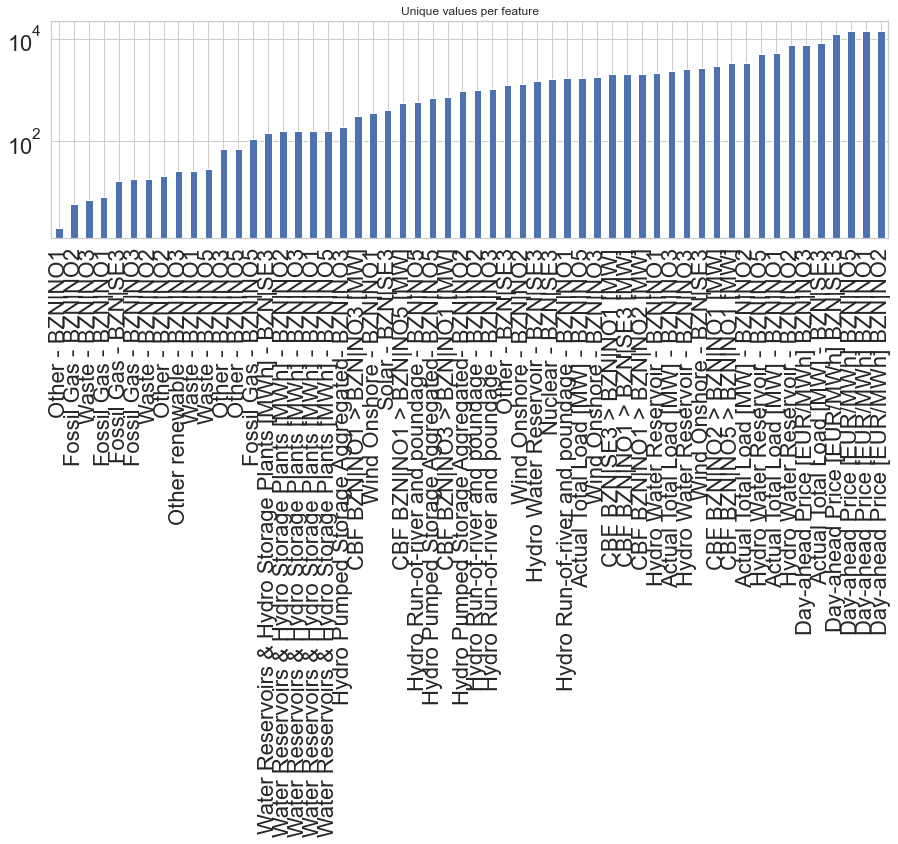

In [282]:
# For each numerical feature compute number of unique entries
unique_values = df.select_dtypes(include="number").nunique().sort_values()

# Plot information with y-axis in log-scale
unique_values.plot.bar(logy=True, figsize=(15, 4), title="Unique values per feature");

First 5 features from left corner of the plot above have the fewest unique values.
- We start by **'Other - BZN|NO1'**. There is a very low variance and 99.9 % of values are 0's. Rest of values are 1's.
&emsp;
- The percentage of 0's in **'Fossil Gas - BZN|NO2'** is 0.8 and the percentage of 4's in 'Fossil Gas - BZN|NO2' is 0.17 . There is a very low variance
&emsp;
- The percentage of 0's in **'Waste - BZN|NO3'** is 0.34. The percentage of values under 6 MW in 'Waste - BZN|NO3' is 0.84
&emsp;
- The percentage of 0's in **'Fossil Gas - BZN|NO1'** is 0.83, by plotting 'Fossil Gas - BZN|NO1' we understand generation is 0 after July 2020. Since data is not consistent and can not be used for our model , we shall drop 'Fossil Gas - BZN|NO1'.
&emsp;
- The percentage of 0's in 'Fossil Gas - BZN|SE3' is 0.99, after plotting the feature over 3 years , we understand that there are no generation in 2020 and 2021, only in 2022.


#### Other - BZN|NO1

In [283]:
# Examine how often specific values occur in a column: (low variance)
distinct_values_Other_NO1 =df['Other - BZN|NO1'].value_counts()
distinct_values_Other_NO1

0.0    26280
1.0       24
Name: Other - BZN|NO1, dtype: int64

In [284]:
# The percentage of 0's in 'Other - BZN|NO1'
df['Other - BZN|NO1'].where(df['Other - BZN|NO1'] == 0).count()/ df.shape[0]

0.9990875912408759

#### Fossil Gas - BZN|NO2

In [285]:
# Examine how often specific values occur in a column
distinct_values_gas_NO1 =df['Fossil Gas - BZN|NO2'].value_counts()
distinct_values_gas_NO1

0.0    21093
4.0     4517
3.0      551
5.0      129
2.0        7
1.0        1
Name: Fossil Gas - BZN|NO2, dtype: int64

In [286]:
# The percentage of 0's in 'Fossil Gas - BZN|NO2' is 0.8
# The percentage of 4's in 'Fossil Gas - BZN|NO2' is 0.17
df['Fossil Gas - BZN|NO2'].where(df['Fossil Gas - BZN|NO2'] == 0).count()/ df.shape[0]
df['Fossil Gas - BZN|NO2'].where(df['Fossil Gas - BZN|NO2'] == 4).count()/ df.shape[0]


0.1717229318734793

#### 'Waste - BZN|NO3’
Electricity generation values under 6 MW represents very negligible production, mean value for daily load NO1 is 39000 MW. Therefore, values under 6MW are very unlikely to indicate price changes or be useful for our model.

In [287]:
# The percentage of 0's in 'Waste - BZN|NO3' is 0.34
df['Waste - BZN|NO3'].where(df['Waste - BZN|NO3'] == 0).count()/ df.shape[0]
# The percentage of values under 6 MW in 'Waste - BZN|NO3' is 0.84
df['Waste - BZN|NO3'].where(df['Waste - BZN|NO3'] < 6).count()/ df.shape[0]

0.8419631995133819

In [288]:
distinct_values_waste_N03 =df['Waste - BZN|NO3'].value_counts()
distinct_values_waste_N03

0.0    9173
6.0    4152
5.0    3405
4.0    2854
1.0    2545
2.0    2130
3.0    2040
Name: Waste - BZN|NO3, dtype: int64

#### Fossil Gas - BZN|NO

In [289]:
# The percentage of 0's in 'Fossil Gas - BZN|NO1' is 0.83
df['Fossil Gas - BZN|NO1'].where(df['Fossil Gas - BZN|NO1'] == 0).count()/ df.shape[0]

0.8329151459854015

In [290]:
distinct_values_gas_NO1 =df['Fossil Gas - BZN|NO1'].value_counts()
distinct_values_gas_NO1

0.0     21909
22.0     2611
25.0     1530
23.0      153
13.0       48
12.0       24
20.0       13
24.0       11
Name: Fossil Gas - BZN|NO1, dtype: int64

Generation is 0 after July 2020, cannot be used for our model.

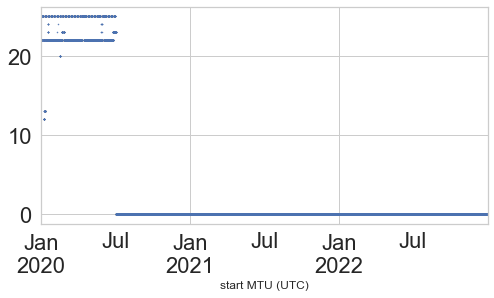

In [291]:
df['Fossil Gas - BZN|NO1'].plot(lw=0, marker=".", markersize=1 , figsize = (8,4));

#### Fossil Gas - BZN|SE3

In [292]:
distinct_values_gas_SE3 =df['Fossil Gas - BZN|SE3'].value_counts()
distinct_values_gas_SE3

0.0     26209
90.0       35
45.0       27
15.0       10
11.0        3
3.0         3
54.0        2
20.0        2
26.0        2
17.0        2
7.0         2
5.0         1
87.0        1
24.0        1
40.0        1
64.0        1
27.0        1
Name: Fossil Gas - BZN|SE3, dtype: int64

In [293]:
# The percentage of 0's in 'Fossil Gas - BZN|SE3' is 0.99
df['Fossil Gas - BZN|SE3'].where(df['Fossil Gas - BZN|SE3'] == 0).count()/ df.shape[0]

0.9963883819951338

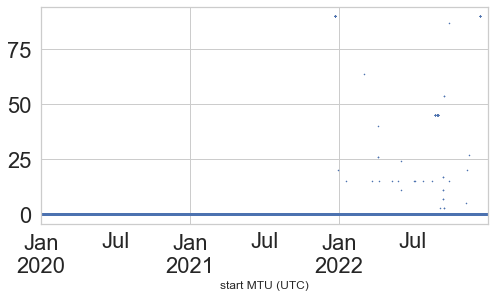

In [294]:
df['Fossil Gas - BZN|SE3'].plot(lw=0, marker="*", markersize=1, figsize = (8,4));

## 2. Quality Investigation

### 2.1 Missing values
we should handle missing values after splitting to avoid data leakage.

In [295]:
# Missing values in each colum in descending order, ' Other renewable - BZN|NO3' column has the most missing values(73).
missing_val_per_feature= df.isna().sum().sort_values(ascending = False)
missing_val_per_feature

Other renewable - BZN|NO3                                  73
CBF BZN|NO1 > BZN|NO3 [MW]                                 31
CBF BZN|NO1 > BZN|NO2 [MW]                                 31
CBF BZN|NO2 > BZN|NO1 [MW]                                 31
CBF BZN|NO5 > BZN|NO1 [MW]                                 31
CBF BZN|NO1 > BZN|NO5 [MW]                                 31
CBF BZN|NO3 > BZN|NO1 [MW]                                 31
Fossil Gas - BZN|NO2                                        6
Hydro Water Reservoir - BZN|NO3                             5
Waste - BZN|NO2                                             5
Waste - BZN|NO5                                             5
Hydro Water Reservoir - BZN|NO5                             5
Hydro Run-of-river and poundage - BZN|NO5                   5
Hydro Pumped Storage Aggregated- BZN|NO5                    5
Fossil Gas - BZN|NO5                                        5
Wind Onshore - BZN|NO3                                      5
Waste - 

In [296]:
# % of missing values in each feature in descending order
# 'Other renewable - BZN|NO3' has most percentage of missing values.
mis_val_percent = 100 * df.isnull().sum() / len(df)
mis_val_percent.sort_values(ascending= False)

Other renewable - BZN|NO3                                  0.277524
CBF BZN|NO1 > BZN|NO3 [MW]                                 0.117853
CBF BZN|NO1 > BZN|NO2 [MW]                                 0.117853
CBF BZN|NO2 > BZN|NO1 [MW]                                 0.117853
CBF BZN|NO5 > BZN|NO1 [MW]                                 0.117853
CBF BZN|NO1 > BZN|NO5 [MW]                                 0.117853
CBF BZN|NO3 > BZN|NO1 [MW]                                 0.117853
Fossil Gas - BZN|NO2                                       0.022810
Hydro Water Reservoir - BZN|NO3                            0.019009
Waste - BZN|NO2                                            0.019009
Waste - BZN|NO5                                            0.019009
Hydro Water Reservoir - BZN|NO5                            0.019009
Hydro Run-of-river and poundage - BZN|NO5                  0.019009
Hydro Pumped Storage Aggregated- BZN|NO5                   0.019009
Fossil Gas - BZN|NO5                            

In [297]:
# There are 102 rows missing values for at least one feature. 2020-01-13 is a complete day with missing valus for import and export within Norwegian bidding zones.
df[df.isna().any(axis=1)]

,Day-ahead Price [EUR/MWh] BZN|NO1,Day-ahead Price [EUR/MWh] BZN|NO2,Day-ahead Price [EUR/MWh] BZN|NO3,Day-ahead Price [EUR/MWh] BZN|NO5,Day-ahead Price [EUR/MWh] BZN|SE3,Actual Total Load [MW] - BZN|NO1,Actual Total Load [MW] - BZN|NO2,Actual Total Load [MW] - BZN|NO3,Actual Total Load [MW] - BZN|NO5,Actual Total Load [MW] - BZN|SE3,...,CBF BZN|NO1 > BZN|NO3 [MW],CBF BZN|NO5 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|NO5 [MW],CBF BZN|SE3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|SE3 [MW],Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO5,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3
start MTU (UTC),,,,,,,,,,,,,,,,,,,,,
2020-01-12 23:00:00,24.92,24.92,22.52,24.92,22.52,4688.0,4442.0,3263.0,2011.0,9848,...,NaN,NaN,NaN,1750,0,3844000.0,24560000.0,5541000.0,11074000.0,2189000.0
2020-01-13 00:00:00,24.54,24.54,23.91,24.54,23.91,4427.0,4354.0,3172.0,1986.0,9747,...,NaN,NaN,NaN,1442,0,3718000.0,24476000.0,5285000.0,10810000.0,2168000.0
2020-01-13 01:00:00,24.66,24.66,23.96,24.66,23.96,4387.0,4365.0,3192.0,1972.0,9741,...,NaN,NaN,NaN,1449,0,3718000.0,24476000.0,5285000.0,10810000.0,2168000.0
2020-01-13 02:00:00,24.85,24.85,24.26,24.85,24.26,4402.0,4402.0,3114.0,1964.0,9830,...,NaN,NaN,NaN,1351,0,3718000.0,24476000.0,5285000.0,10810000.0,2168000.0
2020-01-13 03:00:00,25.33,25.33,25.01,25.33,25.01,4506.0,4417.0,3193.0,2027.0,10047,...,NaN,NaN,NaN,1372,0,3718000.0,24476000.0,5285000.0,10810000.0,2168000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-02-03 12:00:00,58.92,51.79,50.31,58.92,58.92,7132.0,5878.0,4296.0,2691.0,15182,...,0.0,2788.0,0.0,0,1433,3195000.0,24358000.0,4917000.0,9289000.0,1612000.0
2021-02-15 13:00:00,50.28,50.28,46.09,50.28,50.28,7554.0,6246.0,4183.0,2651.0,14399,...,0.0,2857.0,0.0,0,824,2581663.0,21997976.0,4169409.0,7744098.0,1341000.0
2021-06-16 11:00:00,50.09,50.09,33.41,50.09,70.45,3292.0,3792.0,2809.0,1789.0,9204,...,4.0,1832.0,0.0,0,1372,4270695.0,22198664.0,6275868.0,8674483.0,2026000.0


### 2.2 Duplicate Values
Since proving that the two concentrations are under the exact same conditions , is impossible for us. We trust the datasource for this dataset which is European Network of Transmission System Operators for Electricity(https://transparency.entsoe.eu/).

### 2.3 Unwanted and invalid values :

Invalid values can be even more dangerous than missing values, they are often more challenging to detect. Based on our analysis there are no unwanted values , only NaN values which will be handled after EDA in cleaning process.

### Outliers :
Outliers represent measurement errors, data entry or processing errors, or poor sampling
Not all outliers are problematic some outliers represent natural variations in the population, and they should be left as is in the dataset. These are called true outliers. We do not have any reason to remove outliers , we trust our dataprovider(entso-e). Normalizing outliers is not an option for this project since we risk significantly skewing the regression results. Effects of Outliers are ;

1. Skewing of mean and standard deviation
2. Could significantly affect significance readings when generating regression analysis
3. Can give us false readings on the magnitude of correlations

But we are going to study outliers after feature correlation section. we shall divide the dataset in 5 categories and study each of them closer for finding more about outliers.


## 3. Content Investigation


### 3.1 Plotting all features
To study trend, seasonality and distribution for each feature.

##### .plot()
- lw=0: lw stands for line width. 0 means that we don’t want to show any lines
- marker=".": Instead of lines, we tell the plot to use . as markers for each data point
- layout=(-1, 4): This parameter tells pandas how many rows and columns to use for the subplots. The -1 means “as many as needed”, while the 2 means to use 2 columns per row.
- figsize=(20, 55), markersize=1: To make sure that the figure is big enough, figure height is roughly the number of features
##### Day-ahead prices:
- We can clearly see that the seasonality of day-ahead prices for different bidding zones matches. There are huge volatilises in prices after 2021. One of the biggest spikes in prices happened in February 2022 after  Russia invaded Ukraine. looking at day-ahead price subplots, there are huge spikes in prices especially around January 2022 as a result of the Ukraine war and the disrupted energy supply chain in Europe.

##### Total Load :
- The seasonality of total load for different bidding zones matches. The minimum load is around summer(July) and the maximum load is around January for each year.

##### Imports and exports NO1:
- imports from NO3 is quite more than the exports to NO3.
-  Imports from NO2 are almost 2 times the exports to NO2.  Around June 2022 we see a big drop in imports from NO2 which lasted until August 2022. At the same time period, there is a 100% increase in the exports to NO2.
- Imports fra NO5 are almost 3 times higher than exports to NO5.
- Most exports from NO1 is to NO3 og SE3.

#### Generation per unit type:
- NO1 :
	- Zero fossil Gas after the second quarter of 2020
	- 200 % increase for Hydro Run-of-river and poundage after October 2021
	- 50 % increase for wind onshore in 2022 compared to 2021
	- Other containing only 0, have to drop it after EDA
	- Waste has a sideways trend after a temporary drop around Mars 2021.
	- Water Reservoirs & Hydro Storage Plants in NO1 is the second-biggest Water Reservoirs & Hydro Storage Plants in 5 zones right after NO3. Matches the seasonality for Norwegian bidding zones, but not the Swedish bidding zone.
- NO2:
     - Small values for fossil gas under 5 MW
	- 200 % increase for Hydro Run-of-river and poundage after October 2021. And 3 times higher values than NO1 with side vise trend
	- Other values is 0 MW after July 2020
    - Hydro pumped storage aggregated has a downward trend as it decreases by 50 % after October 2021.

- NO3:
    - Zero fossil Gas after the second quarter of 2020
	- Biggest generation type for NO3 is Water Reservoirs & Hydro Storage Plants. This is the biggest generation source in all 5 zones in this dataset.
	- 350-400 % increase for Hydro Run-of-river and poundage after October 2021
	- 80% increase for wind onshore after October 2022
	- Power generation from waste in NO3 is the least power generation compared to other bidding zones, with values under 7 MW in 2020-2022.
    - Other is 0 after November 2021. and from the same period 'Other Renewable ' have some values.

- NO5 :
	- Fossil gas has a big downward trend after May 2022 by 70 %.
	- 300 % increase for Hydro Run-of-river and poundage after October 2021. Still the least among this type of power generation in NO1, NO2, and NO3.
	- Waste has a side wise trend
	- 'Other' decreased to 0 after May 2020.
	- There are no values for 'Hydro pumped storage aggregated ' before July 2022
    - Water Reservoirs & Hydro Storage Plants in NO5 is the least power generation compared to other bidding zones.

  SE3 :
	- Fossil gas increased after January 2022, from 0 to 20, and a peak at 80 MW. Result from war.
	- Does not have 'Hydro run.off.river and poundage'.
	- Very stable and side wise tends for wind onshore with higher values than Norwegian zones since 2020.
	- Generated over 5000 MW using Nuclear Technology, right after December 2021.
	- At the same time 'Other' picks up from 0 to 15000 MW
	- Downward Trend for 'Water Reservoirs & Hydro Storage Plants' since 2020, with 50% decrease from 2021 to 2022.

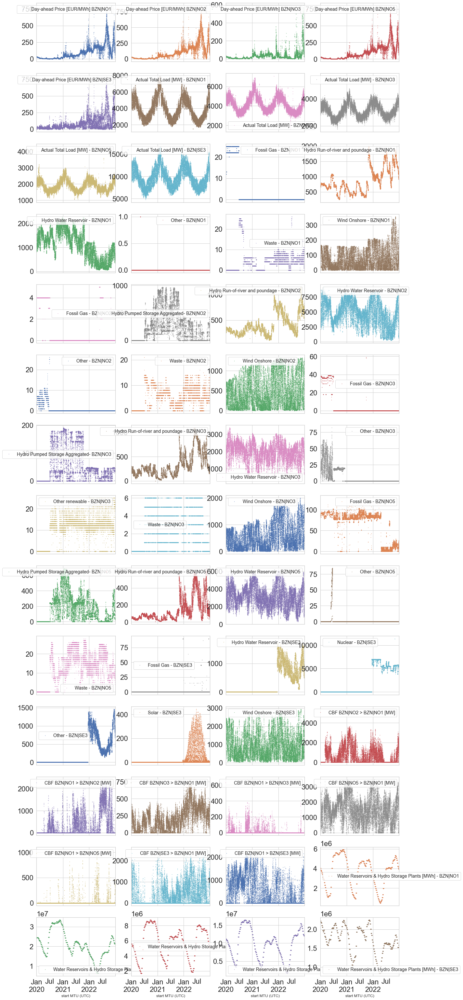

In [298]:
df.plot(lw=0, marker=".", subplots=True, layout=(-1, 4),
          figsize=(20, 55), markersize=1);


In [299]:
df_2020 = df.loc[ '2020-01-01 ' : '2020-12-31 ']
df_2021 = df.loc[ '2021-01-01 ' : '2021-12-31 ']
df_2022 = df.loc[ '2022-01-01 ' : '2022-12-31 ']

array([[<AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>],
       [<AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>],
       [<AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>],
       [<AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>],
       [<AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>],
       [<AxesSubplot:xlabel='start 

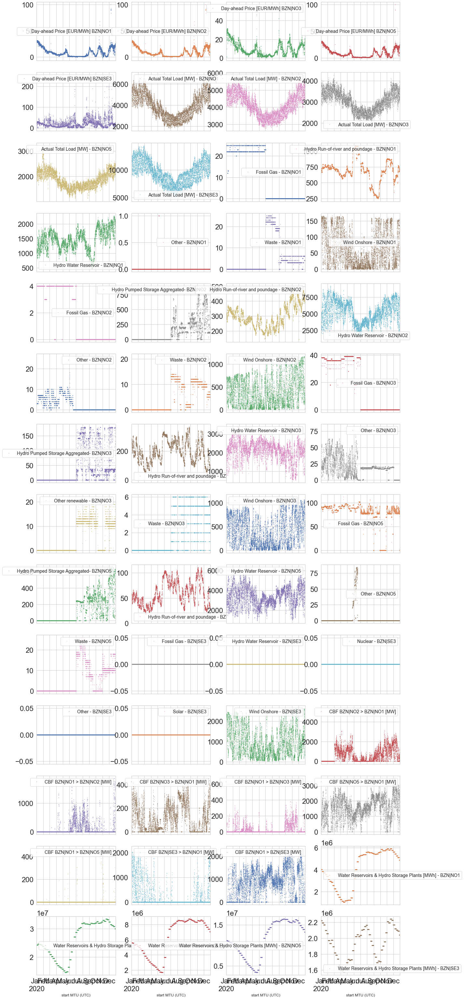

In [300]:
df_2020.plot(lw=0, marker=".", subplots=True, layout=(-1, 4),
             figsize=(20, 55), markersize=1)

#### Plotting low quality features for 2020 and 2021

<Figure size 432x288 with 0 Axes>

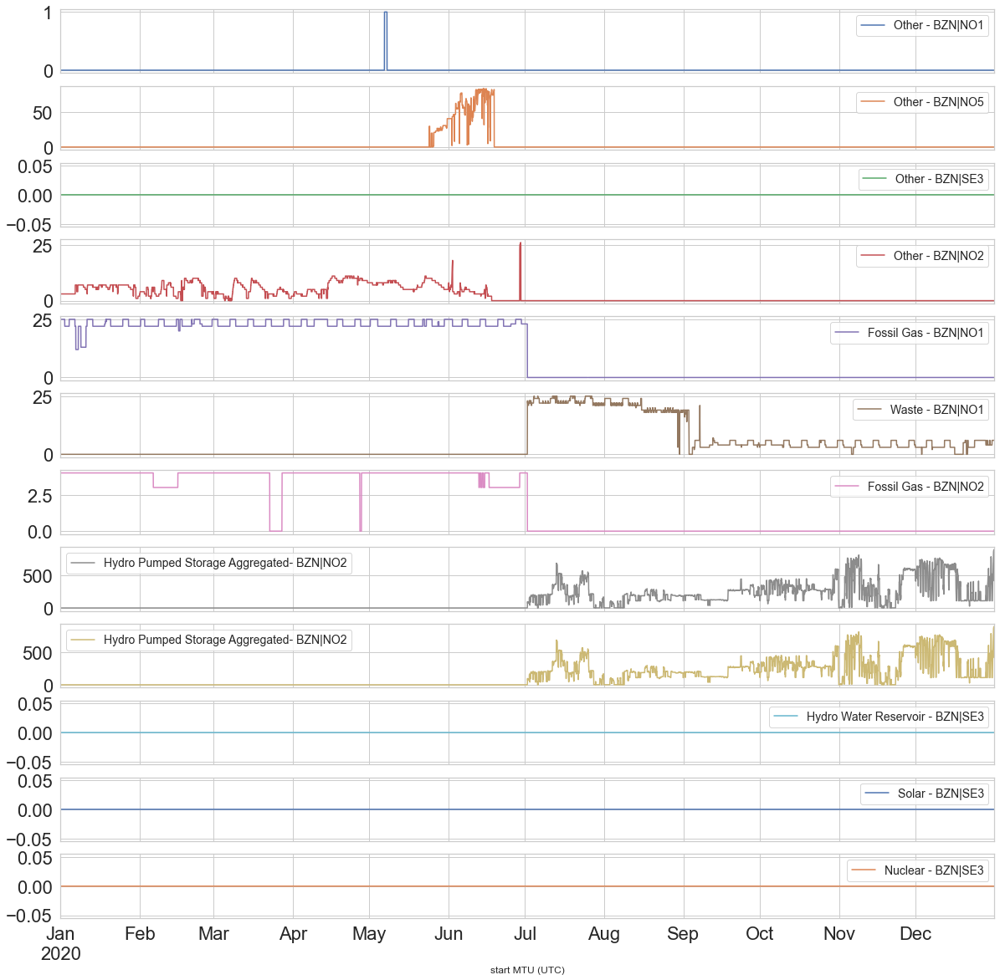

In [301]:
low_quality_features_names_2020 = ['Other - BZN|NO1',
'Other - BZN|NO5',
'Other - BZN|SE3',
'Other - BZN|NO2',
'Fossil Gas - BZN|NO1',
'Waste - BZN|NO1',
'Fossil Gas - BZN|NO2',
'Hydro Pumped Storage Aggregated- BZN|NO2',
'Hydro Pumped Storage Aggregated- BZN|NO2',
'Hydro Water Reservoir - BZN|SE3',
'Solar - BZN|SE3', 'Nuclear - BZN|SE3']

#plt.rc('legend', fontsize=24)
#plt.rc('xtick', labelsize=22)
#plt.rc('ytick', labelsize=22)
plt.figure()
low_quality_features_2020 = df_2020[low_quality_features_names_2020]
low_quality_features_2020.plot(subplots=True, figsize=(20, 20))
#plt.xlabel('')
plt.show()

array([[<AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>],
       [<AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>],
       [<AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>],
       [<AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>],
       [<AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>,
        <AxesSubplot:xlabel='start MTU (UTC)'>],
       [<AxesSubplot:xlabel='start 

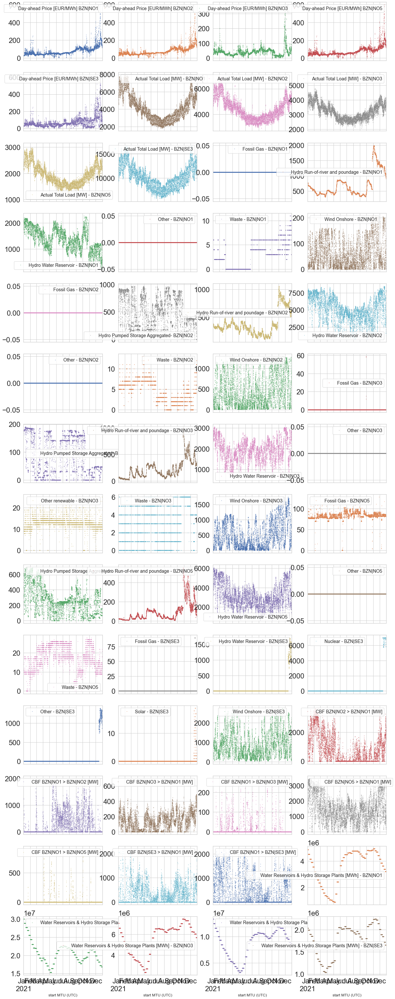

In [302]:
df_2021.plot(lw=0, marker=".", subplots=True, layout=(-1, 4),
        figsize=(20, 55), markersize=1)

<Figure size 432x288 with 0 Axes>

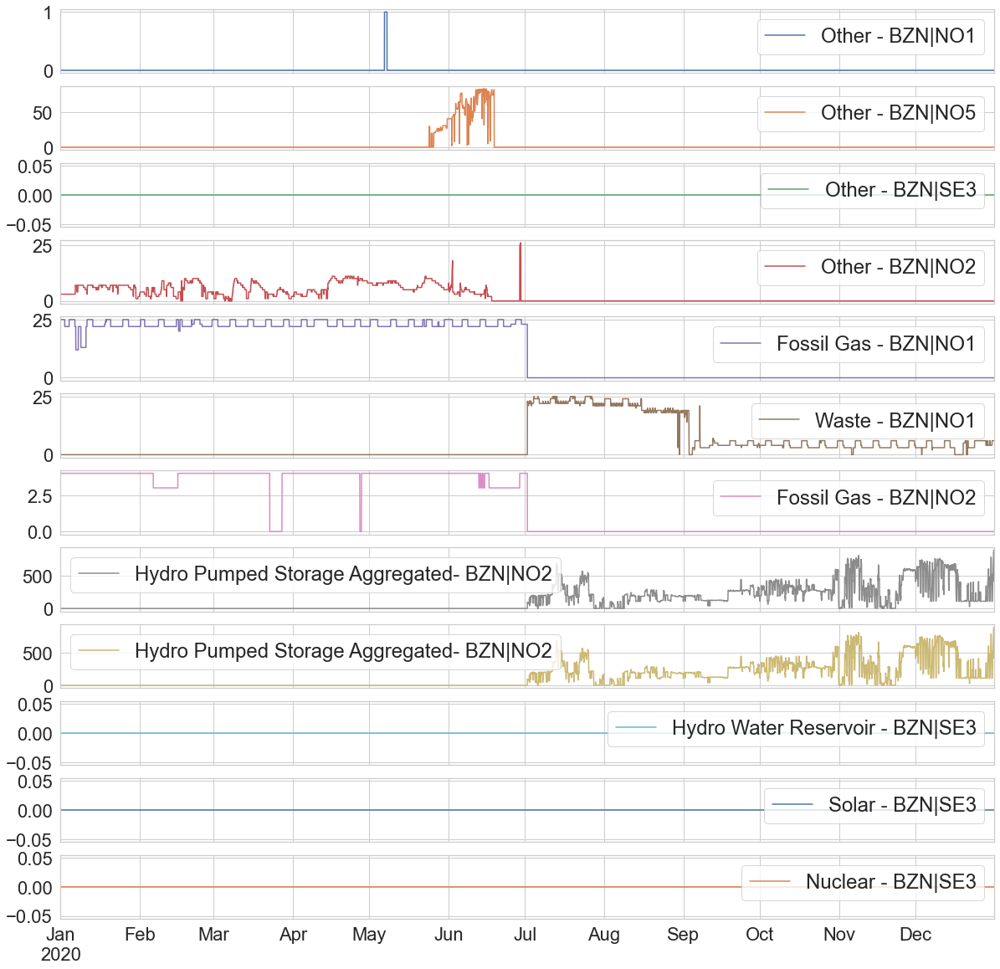

In [303]:
low_quality_features_names_2021 = ['Other - BZN|NO1',
                                   'Other - BZN|NO2',
                                   'Other - BZN|NO5',
                                   'Other - BZN|SE3',
                                   'Fossil Gas - BZN|NO1',
                                   'Fossil Gas - BZN|NO2',
                                   'Fossil Gas - BZN|NO3',
                                   'Fossil Gas - BZN|SE3',
                                   'Hydro Water Reservoir - BZN|SE3',
                                   'Solar - BZN|SE3',
                                   'Nuclear - BZN|SE3']
low_quality_features_2021 = df_2021[low_quality_features_names_2021]
plt.rc('legend', fontsize=24)
plt.rc('xtick', labelsize=22)
plt.rc('ytick', labelsize=22)
plt.figure()
low_quality_features_2020 = df_2020[low_quality_features_names_2020]
low_quality_features_2020.plot(subplots=True, figsize=(20, 20))
plt.xlabel('')
plt.show()
low_quality_features_2021.plot(subplots=True, figsize=(20, 20))

#### 3.2 Dropping data instances for 2020 and 2021 (Preprocessing)

Based on the plots above we can see alot of missing values and zero values for generation category around 2020 and 2021. Looking at SE3 , two of the biggest generation units which are 'Nuclear' and 'Hydro Water Reservoir' , do not have any value/data for 2020 and 2021. We can not drop SE3 bidding zone therefore must limit our models to 2022 only. This is also sensible because ukraine war started in 2022 and changed electricity marked dynamics, we see very big spikes in price more often in 2022 compared to the years before. The reason for having 3 years of data was that based on our conducted research on electricity price forcasting models. We had an understanding that at least 1 year testing data is required for forcasting electricity prices. So our model understand seasonally from a whole year and can predict the seasonality and patterns for coming days.

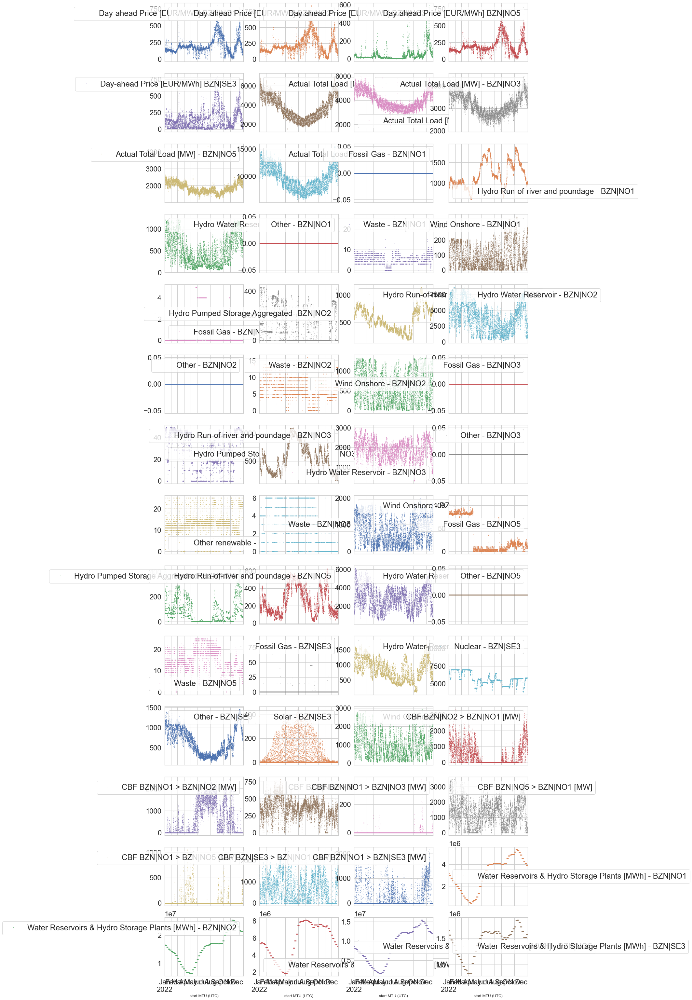

In [304]:
df_2022= df.loc[ '2022-01-01' : '2022-12-31']
df_2022.plot(lw=0, marker=".", subplots=True, layout=(-1, 4),
             figsize=(20, 55), markersize=1);

#### 3.3 Creating new feature for total import to NO1 (Feature engineering)

In [305]:
import_column_names = [col_name for col_name in df_2022.columns if '> BZN|NO1' in col_name]
# Numpy arrays are more compact than python lists, which uses less memory

# creating a dataset containing only datetime and import to zone NO1 for the different zones
import_columns = df_2022.loc[:, import_column_names]

## Creating Total Import to NO1 using .sum()
total_import_NO1 = import_columns.sum(axis = 1)

# Adding the new feature to our dataframe
df_2022['Total Imports NO1 [MW]'] = total_import_NO1;

df_2022

C:\Users\Isak\AppData\Local\Temp\ipykernel_44424\3684224913.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2022['Total Imports NO1 [MW]'] = total_import_NO1;


,Day-ahead Price [EUR/MWh] BZN|NO1,Day-ahead Price [EUR/MWh] BZN|NO2,Day-ahead Price [EUR/MWh] BZN|NO3,Day-ahead Price [EUR/MWh] BZN|NO5,Day-ahead Price [EUR/MWh] BZN|SE3,Actual Total Load [MW] - BZN|NO1,Actual Total Load [MW] - BZN|NO2,Actual Total Load [MW] - BZN|NO3,Actual Total Load [MW] - BZN|NO5,Actual Total Load [MW] - BZN|SE3,...,CBF BZN|NO5 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|NO5 [MW],CBF BZN|SE3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|SE3 [MW],Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO5,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3,Total Imports NO1 [MW]
start MTU (UTC),,,,,,,,,,,,,,,,,,,,,
2022-01-01 00:00:00,129.30,129.30,41.33,129.30,41.33,4701.0,4440.0,3463.0,1991.0,9612,...,594.0,0.0,1065,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3272.0
2022-01-01 01:00:00,132.08,132.08,42.18,132.08,42.18,4681.0,4480.0,3388.0,1969.0,9601,...,676.0,0.0,927,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3208.0
2022-01-01 02:00:00,111.44,111.44,44.37,111.44,44.37,4620.0,4424.0,3387.0,1911.0,9552,...,436.0,0.0,748,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3225.0
2022-01-01 03:00:00,112.35,112.35,37.67,112.35,37.67,4645.0,4386.0,3376.0,1996.0,9449,...,345.0,0.0,918,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3255.0
2022-01-01 04:00:00,113.90,113.90,39.70,113.90,39.70,4670.0,4375.0,3427.0,1953.0,9614,...,412.0,0.0,826,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3274.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,123.61,123.61,23.82,123.61,11.57,4650.0,4333.0,3612.0,2128.0,9602,...,43.0,0.0,2083,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2893.0
2022-12-31 20:00:00,121.09,121.09,23.93,121.09,14.89,4573.0,4270.0,3605.0,2089.0,9251,...,24.0,0.0,2097,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2840.0
2022-12-31 21:00:00,120.00,120.00,23.75,120.00,9.94,4453.0,4294.0,3479.0,2037.0,9092,...,41.0,0.0,2007,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2747.0


#### 3.4 Creating new feature for total exports from NO1 (Feature engineering)

In [306]:
export_column_names = [col_name for col_name in df_2022.columns if 'BZN|NO1 > ' in col_name]

# creating a dataset containing only datetime and import to zone NO1 for the different zones
export_columns = df_2022.loc[:, export_column_names]

## Creating Total Export to NO1
total_export_NO1 = export_columns.sum(axis = 1)

# Adding the new feature to our dataframe
df_2022['Total Exports NO1 [MW]'] = total_export_NO1;
total_export_nor = df_2022 ['Total Exports NO1 [MW]']
df_2022

C:\Users\Isak\AppData\Local\Temp\ipykernel_44424\4059502009.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2022['Total Exports NO1 [MW]'] = total_export_NO1;


,Day-ahead Price [EUR/MWh] BZN|NO1,Day-ahead Price [EUR/MWh] BZN|NO2,Day-ahead Price [EUR/MWh] BZN|NO3,Day-ahead Price [EUR/MWh] BZN|NO5,Day-ahead Price [EUR/MWh] BZN|SE3,Actual Total Load [MW] - BZN|NO1,Actual Total Load [MW] - BZN|NO2,Actual Total Load [MW] - BZN|NO3,Actual Total Load [MW] - BZN|NO5,Actual Total Load [MW] - BZN|SE3,...,CBF BZN|NO1 > BZN|NO5 [MW],CBF BZN|SE3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|SE3 [MW],Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO5,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3,Total Imports NO1 [MW],Total Exports NO1 [MW]
start MTU (UTC),,,,,,,,,,,,,,,,,,,,,
2022-01-01 00:00:00,129.30,129.30,41.33,129.30,41.33,4701.0,4440.0,3463.0,1991.0,9612,...,0.0,1065,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3272.0,0.0
2022-01-01 01:00:00,132.08,132.08,42.18,132.08,42.18,4681.0,4480.0,3388.0,1969.0,9601,...,0.0,927,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3208.0,0.0
2022-01-01 02:00:00,111.44,111.44,44.37,111.44,44.37,4620.0,4424.0,3387.0,1911.0,9552,...,0.0,748,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3225.0,0.0
2022-01-01 03:00:00,112.35,112.35,37.67,112.35,37.67,4645.0,4386.0,3376.0,1996.0,9449,...,0.0,918,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3255.0,0.0
2022-01-01 04:00:00,113.90,113.90,39.70,113.90,39.70,4670.0,4375.0,3427.0,1953.0,9614,...,0.0,826,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3274.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,123.61,123.61,23.82,123.61,11.57,4650.0,4333.0,3612.0,2128.0,9602,...,0.0,2083,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2893.0,0.0
2022-12-31 20:00:00,121.09,121.09,23.93,121.09,14.89,4573.0,4270.0,3605.0,2089.0,9251,...,0.0,2097,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2840.0,0.0
2022-12-31 21:00:00,120.00,120.00,23.75,120.00,9.94,4453.0,4294.0,3479.0,2037.0,9092,...,0.0,2007,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2747.0,0.0


#### 3.5 Remove features with very low variance (Feature selection)
Reducing number of features is usually done after EDA is finished, but clearly there are some features that does not help our model and are useless. Reason for that is very low variance, this means many rows with 0 values or just not big enough values (MW) that we can consider them as factors for fluctuating prices in the year 2022. They will add to the complexity and increase the predicting error. Quality of data is very important and data should be consistent. The main electricity generation in Norway is not fossil energy therefore , 'Fossil Gas' can be dropped for all mentioned reasons. These conclusions are based on the plotting of all features in previous cells and basic ML modelling concepts.


Those features are
- Fossil gas for zones NO1,NO2, NO3, NO5, SE3
- Other for zones NO1, NO2, NO3, No5 (does not include 'Other renewable')

<Figure size 432x288 with 0 Axes>

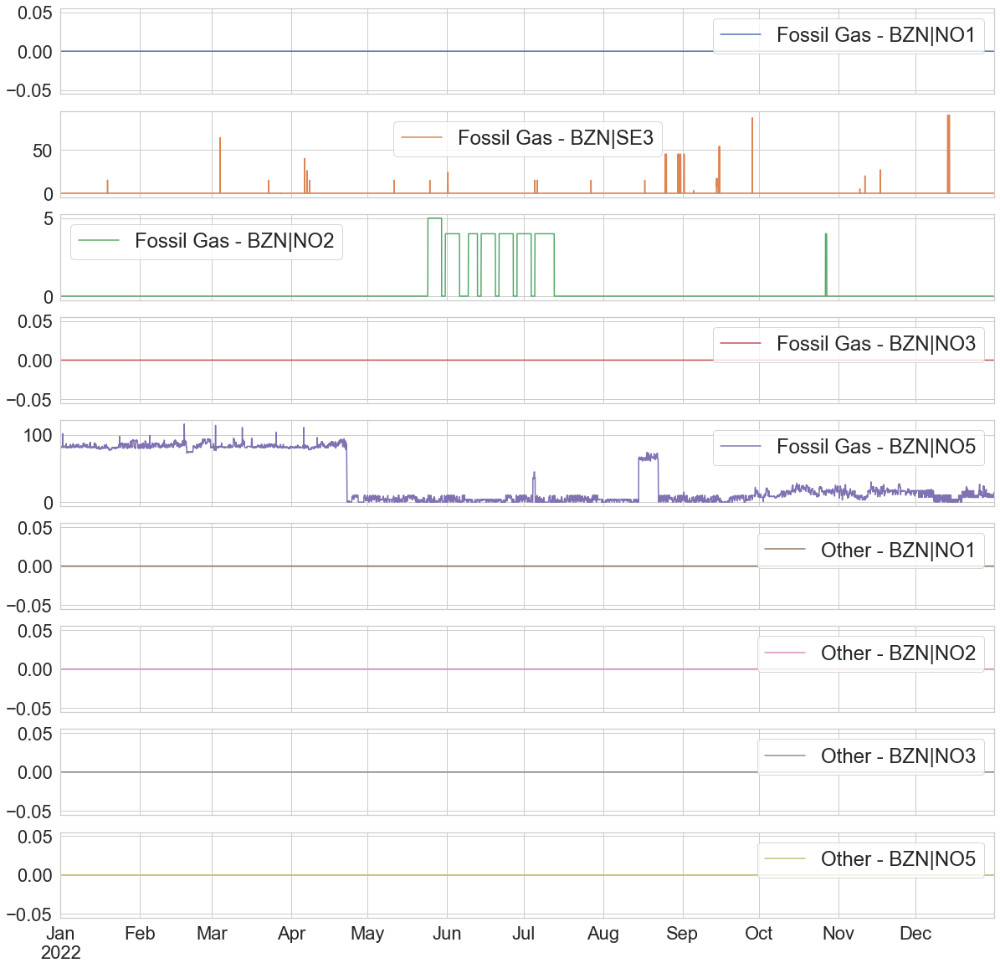

In [307]:
low_variance_column_names_2022= ['Fossil Gas - BZN|NO1', 'Fossil Gas - BZN|SE3',
'Fossil Gas - BZN|NO2', 'Fossil Gas - BZN|NO3',
'Fossil Gas - BZN|NO5', 'Other - BZN|NO1',
'Other - BZN|NO2', 'Other - BZN|NO3', 'Other - BZN|NO5']

low_variance_column_names_2022 = df_2022[low_variance_column_names_2022]
low_variance_column_names_2022.plot(subplots=True, figsize=(20, 20))


In [308]:
df_2022.drop(['Fossil Gas - BZN|NO1', 'Fossil Gas - BZN|SE3',
         'Fossil Gas - BZN|NO2', 'Fossil Gas - BZN|NO3',
         'Fossil Gas - BZN|NO5', 'Other - BZN|NO1',
         'Other - BZN|NO2', 'Other - BZN|NO3', 'Other - BZN|NO5'], inplace =True,  axis = 1)

C:\Users\Isak\AppData\Local\Temp\ipykernel_44424\4125629089.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2022.drop(['Fossil Gas - BZN|NO1', 'Fossil Gas - BZN|SE3',


### 3.6 Feature distribution
We will study feature distribution for each category more in the next section. But at this stage we know that there is no need for normal distribution in our regression analysis. We require Best Linear Unbiased Estimator (BLUE).

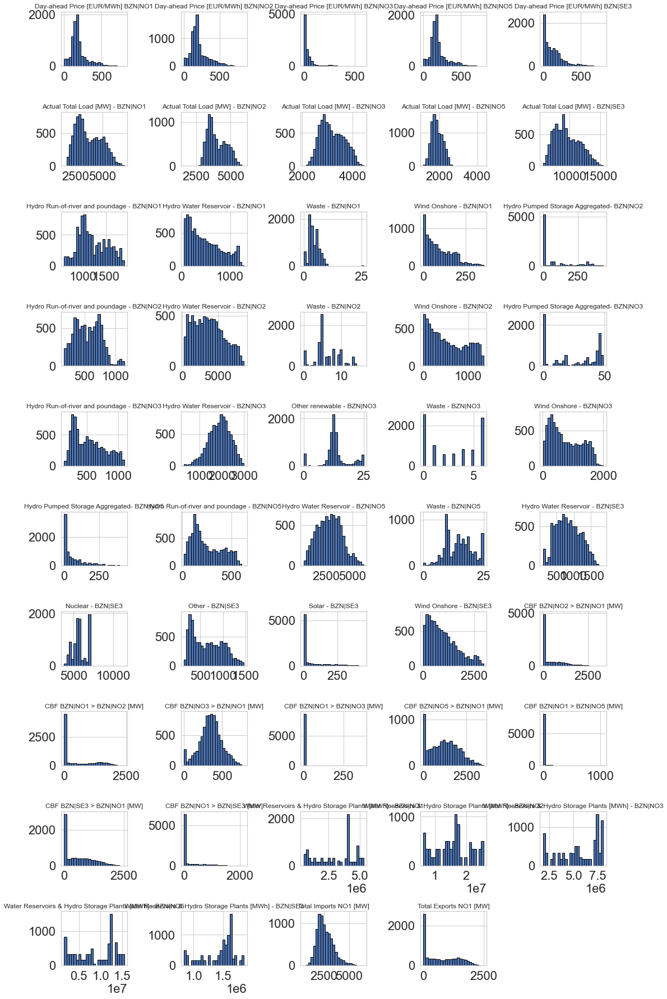

In [309]:
# Plots the histogram for each numerical feature in a separate subplot
df_2022.hist(bins=25, figsize=(15, 25), layout=(-1, 5), edgecolor="black")
plt.tight_layout();

### 3.7 Pair-plot()

In [310]:
# identify numerical features with more or less than 25 unique features. This will be used for .pairPlot()
cols_continuous = df_2022.select_dtypes(include="number").nunique() >= 30
cols_continuous

Day-ahead Price [EUR/MWh] BZN|NO1                           True
Day-ahead Price [EUR/MWh] BZN|NO2                           True
Day-ahead Price [EUR/MWh] BZN|NO3                           True
Day-ahead Price [EUR/MWh] BZN|NO5                           True
Day-ahead Price [EUR/MWh] BZN|SE3                           True
Actual Total Load [MW] - BZN|NO1                            True
Actual Total Load [MW] - BZN|NO2                            True
Actual Total Load [MW] - BZN|NO3                            True
Actual Total Load [MW] - BZN|NO5                            True
Actual Total Load [MW] - BZN|SE3                            True
Hydro Run-of-river and poundage - BZN|NO1                   True
Hydro Water Reservoir - BZN|NO1                             True
Waste - BZN|NO1                                            False
Wind Onshore - BZN|NO1                                      True
Hydro Pumped Storage Aggregated- BZN|NO2                    True
Hydro Run-of-river and po

In [311]:
# Create a new dataframe which only contains the continuous features
df_continuous = df_2022[cols_continuous[cols_continuous].index]
df_continuous.shape

(8760, 44)

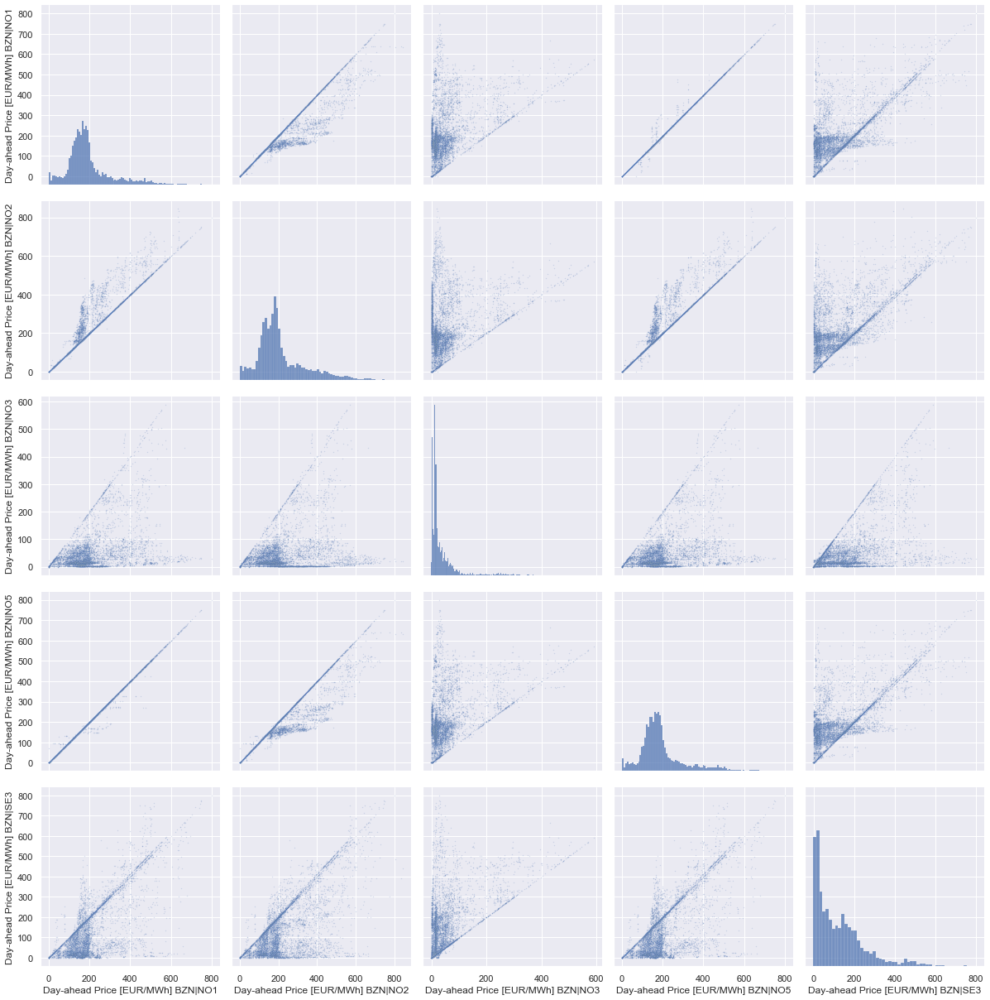

In [312]:
# Pair-plot for first 5 columns , The main-diagonal subplots are the univariate histograms (distributions) for each attribute.
first = df_continuous.iloc[:, 0:5]

sns.set(font_scale = 1)
fig = sns.pairplot( first, height=1.5, plot_kws={"s": 2, "alpha": 0.2} );
fig.fig.set_size_inches(18,18)

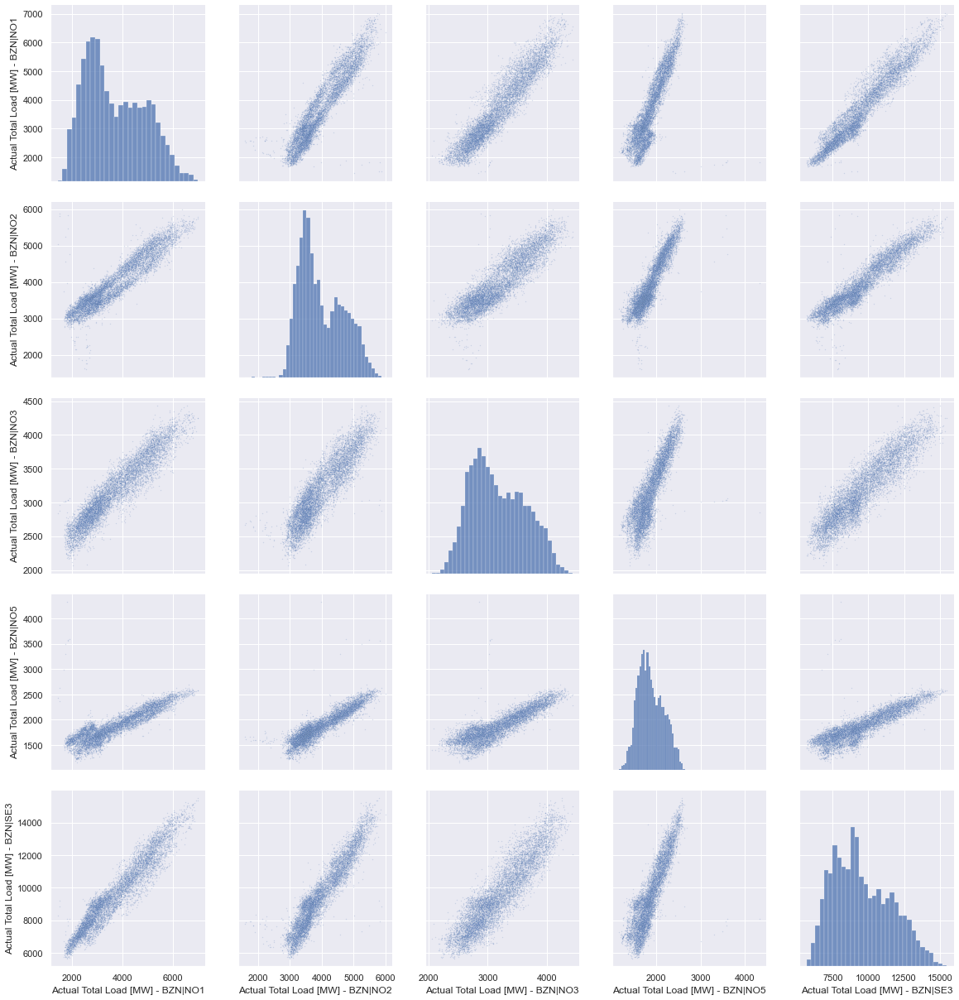

In [313]:
second = df_continuous.iloc[:, 5:10]
#The main-diagonal subplots are the uni-variate histograms (distributions) for each attribute.
sns.set(font_scale = 1)
fig = sns.pairplot( second, height=1.5, plot_kws={"s": 2, "alpha": 0.2} )
fig.fig.set_size_inches(18,18)

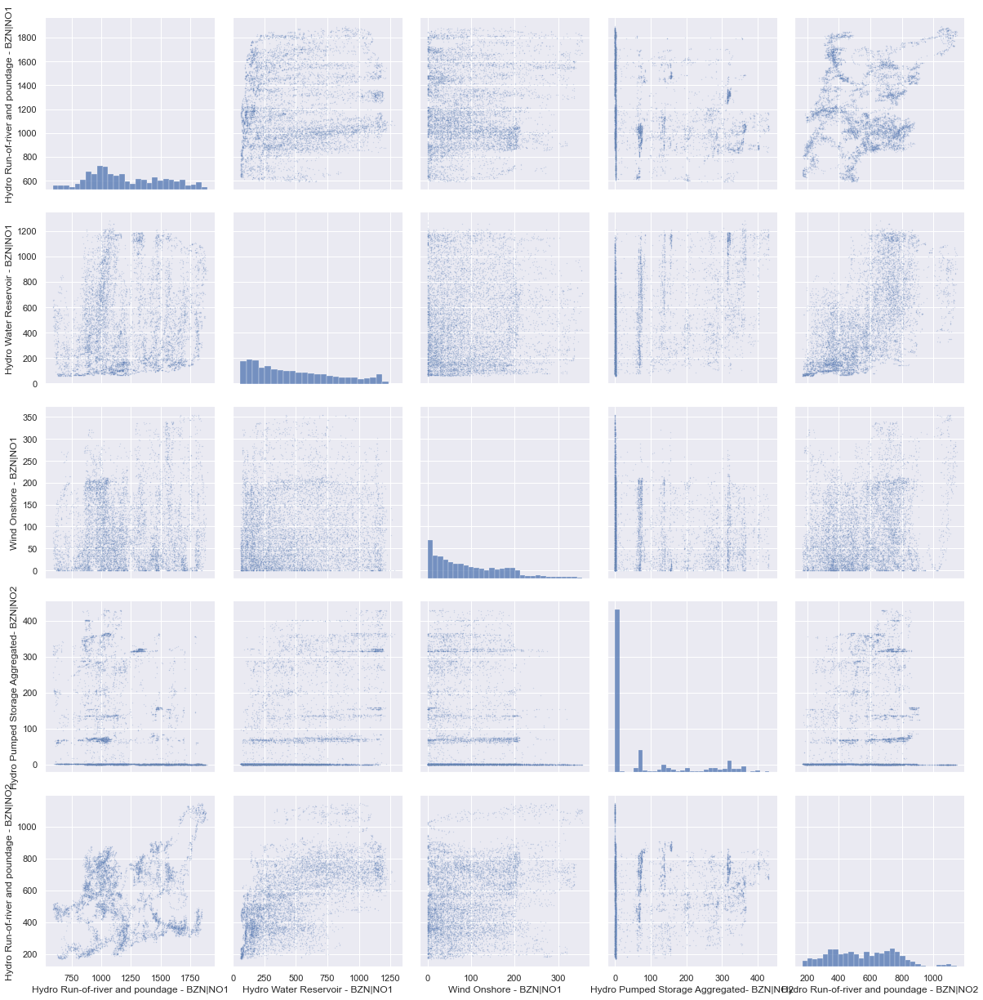

In [314]:
third = df_continuous.iloc[:, 10:15]
#The main-diagonal subplots are the uni-variate histograms (distributions) for each attribute.
sns.set(font_scale = 1)
fig = sns.pairplot( third, height=1.5, plot_kws={"s": 2, "alpha": 0.2} )
fig.fig.set_size_inches(18,18)

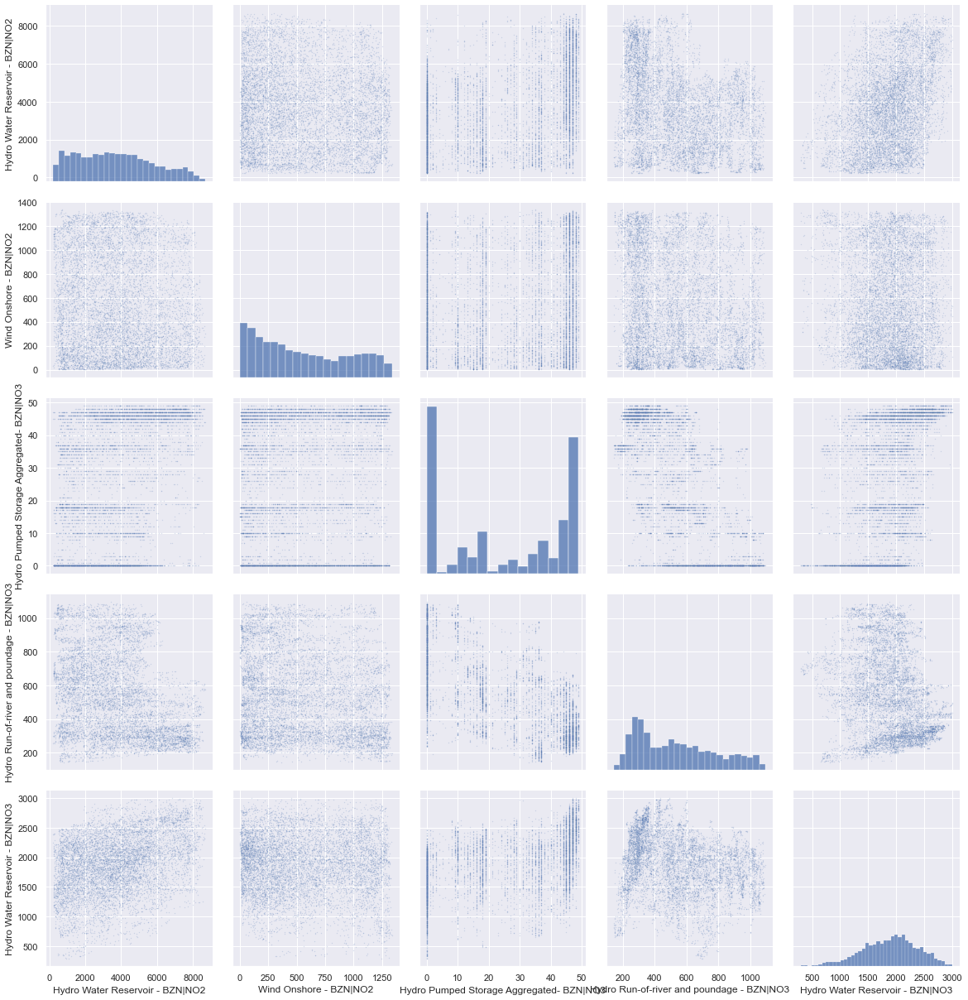

In [315]:
fourth = df_continuous.iloc[:, 15:20]
#The main-diagonal subplots are the uni-variate histograms (distributions) for each attribute.
sns.set(font_scale = 1)
fig = sns.pairplot( fourth, height=1.5, plot_kws={"s": 2, "alpha": 0.2} );
fig.fig.set_size_inches(18,18)

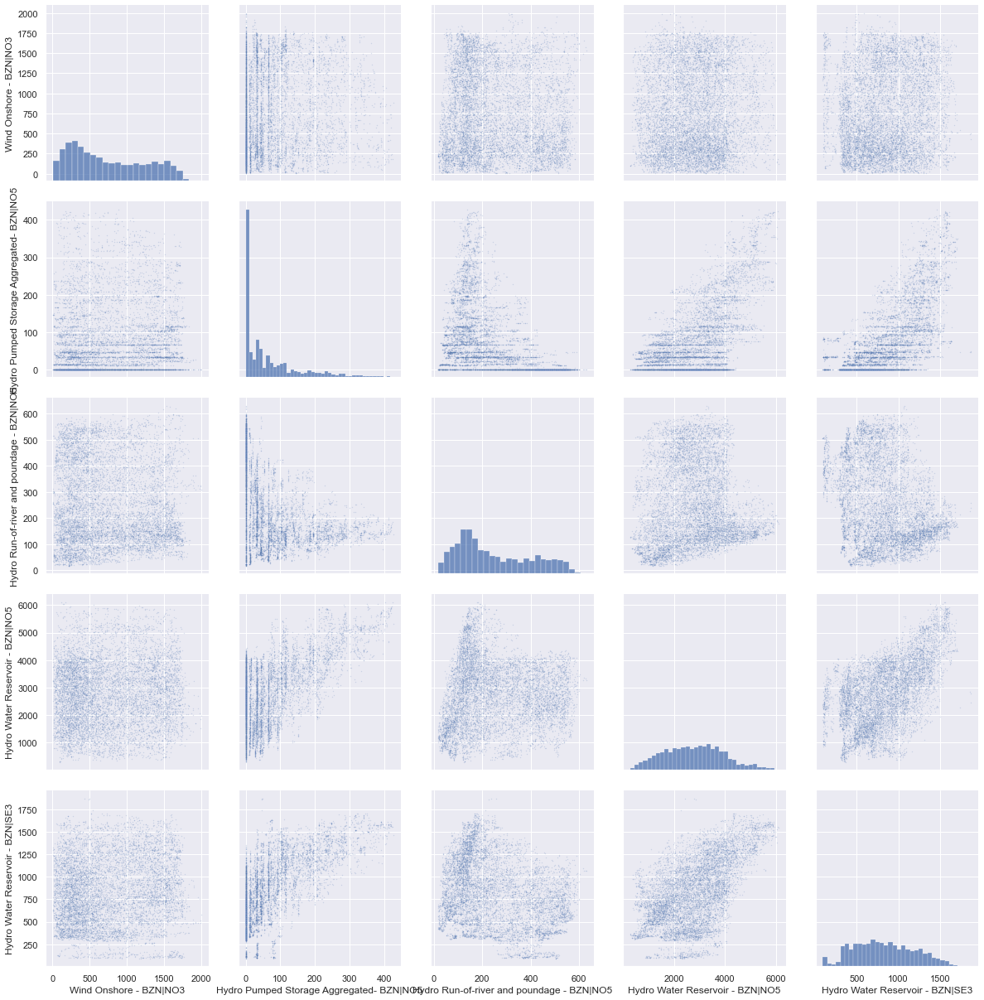

In [316]:
fifth = df_continuous.iloc[:, 20:25]
#The main-diagonal subplots are the uni-variate histograms (distributions) for each attribute.
sns.set(font_scale = 1)
fig = sns.pairplot( fifth, height=1.5, plot_kws={"s": 2, "alpha": 0.2} );
fig.fig.set_size_inches(18,18)

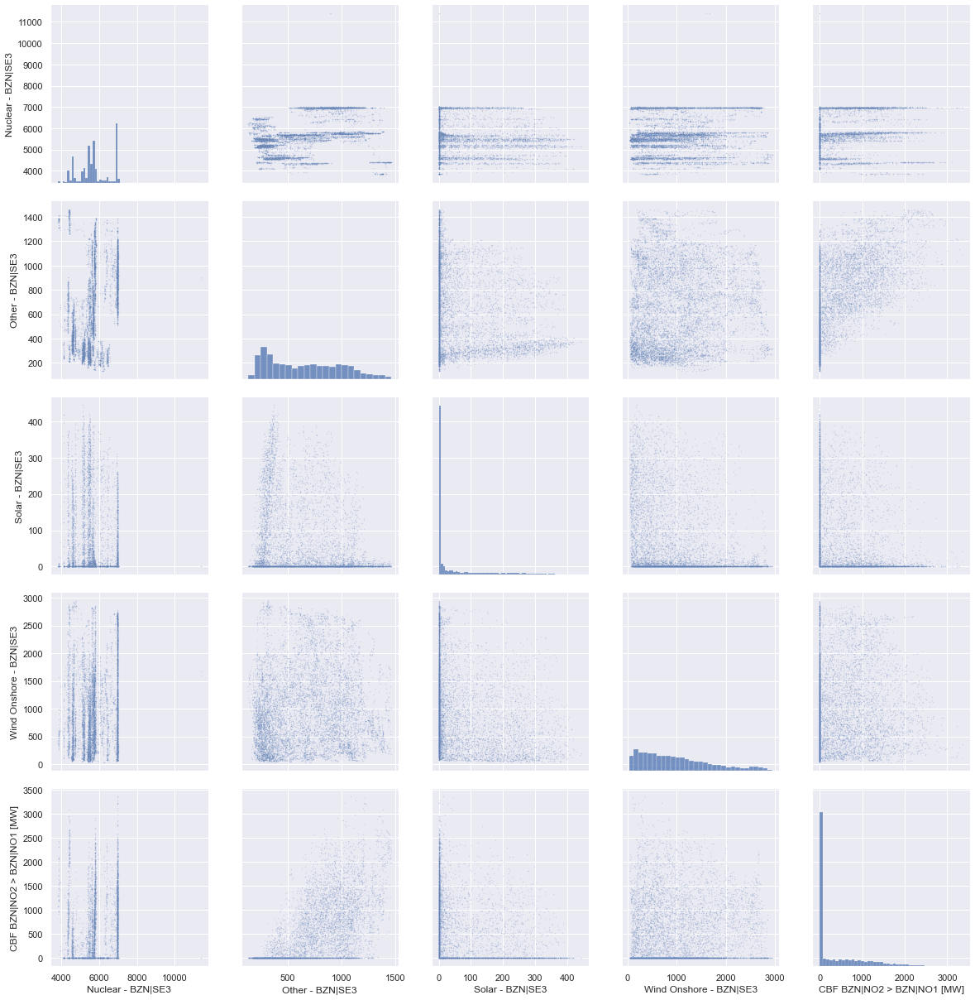

In [317]:
fifth = df_continuous.iloc[:, 25:30]
#The main-diagonal subplots are the uni-variate histograms (distributions) for each attribute.
sns.set(font_scale = 1)
fig = sns.pairplot( fifth, height=1.5, plot_kws={"s": 2, "alpha": 0.2} );
fig.fig.set_size_inches(18,18)

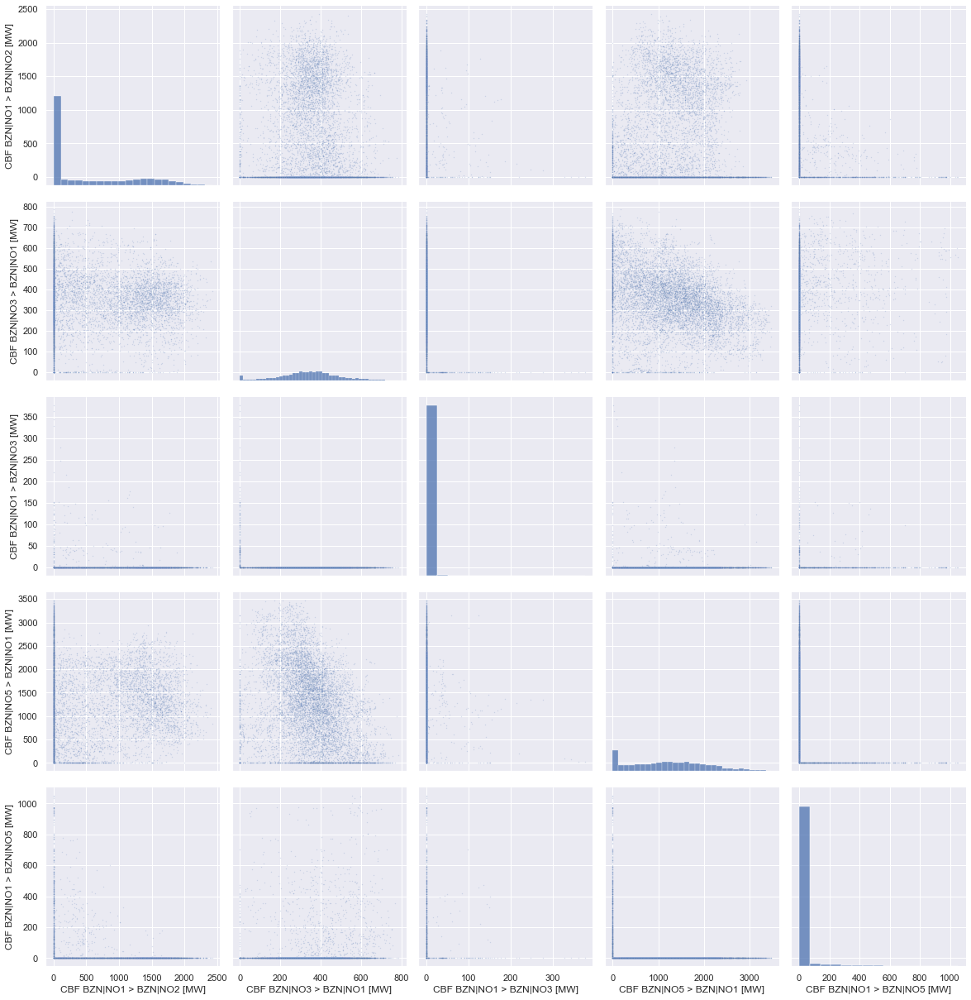

In [318]:
sixth = df_continuous.iloc[:, 30:35]
#The main-diagonal subplots are the uni-variate histograms (distributions) for each attribute.
sns.set(font_scale = 1)
fig = sns.pairplot( sixth, height=1.5, plot_kws={"s": 2, "alpha": 0.2} );
fig.fig.set_size_inches(18,18)

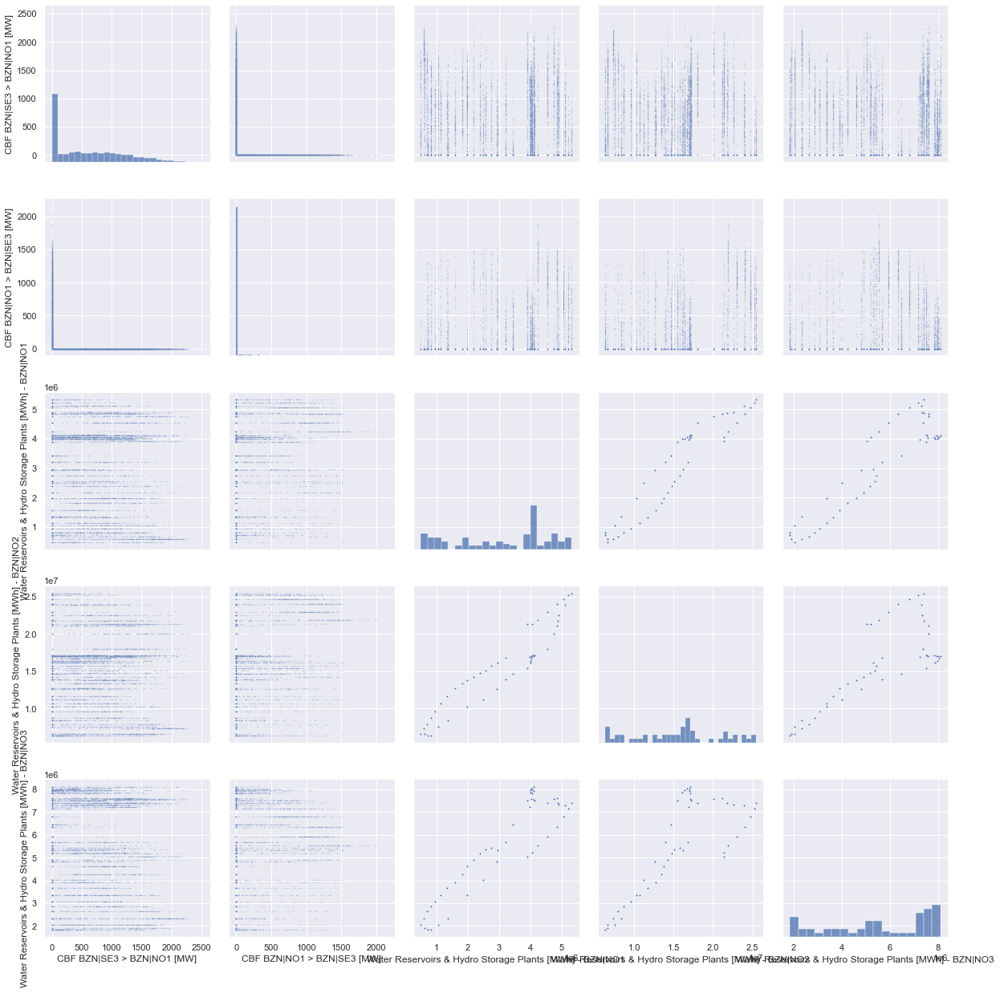

In [319]:
seventh = df_continuous.iloc[:, 35:40]
#The main-diagonal subplots are the uni-variate histograms (distributions) for each attribute.
sns.set(font_scale = 1)
fig = sns.pairplot( seventh, height=1.5, plot_kws={"s": 2, "alpha": 0.2} );
fig.fig.set_size_inches(18,18)

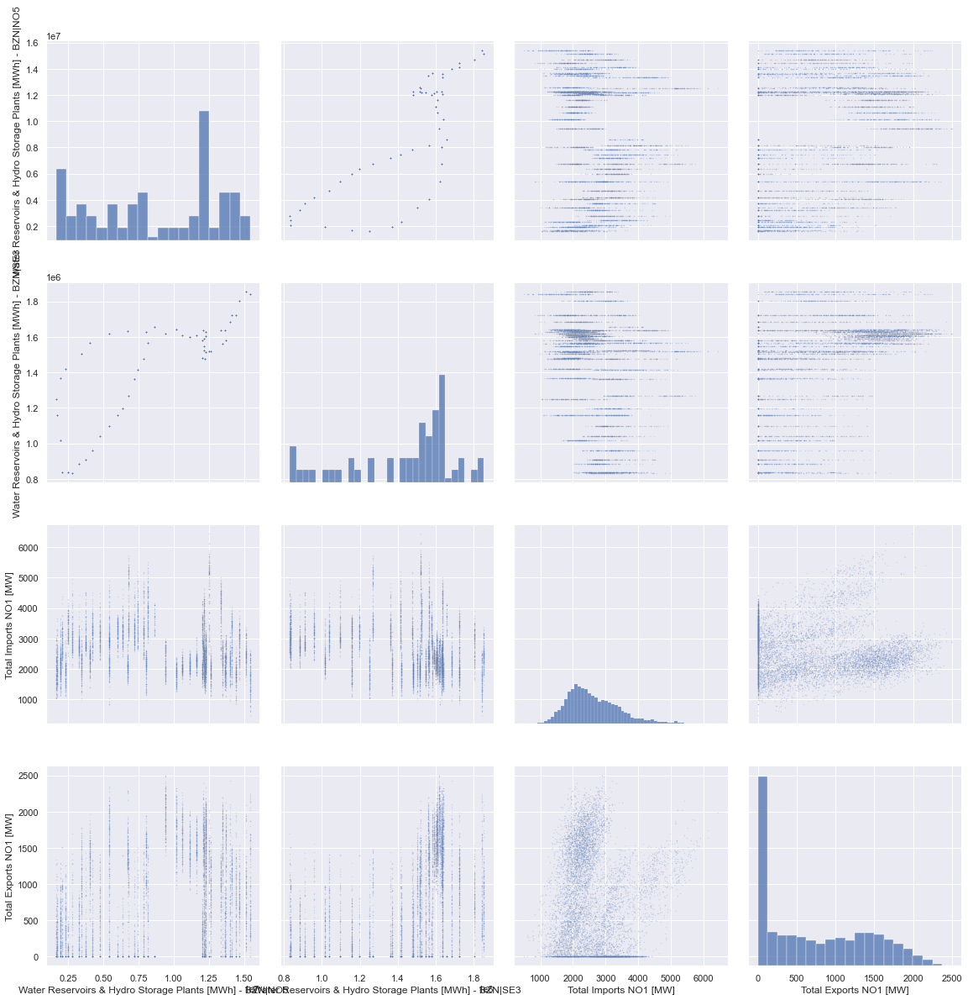

In [320]:
eighth = df_continuous.iloc[:, 40:46]
#The main-diagonal subplots are the uni-variate histograms (distributions) for each attribute.
sns.set(font_scale = 1)
fig = sns.pairplot( eighth, height=1.5, plot_kws={"s": 2, "alpha": 0.2} );
fig.fig.set_size_inches(18,18)

### 3.8  Feature Correlation

C:\Users\Isak\AppData\Local\Temp\ipykernel_44424\141528523.py:5: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cb = plt.colorbar()


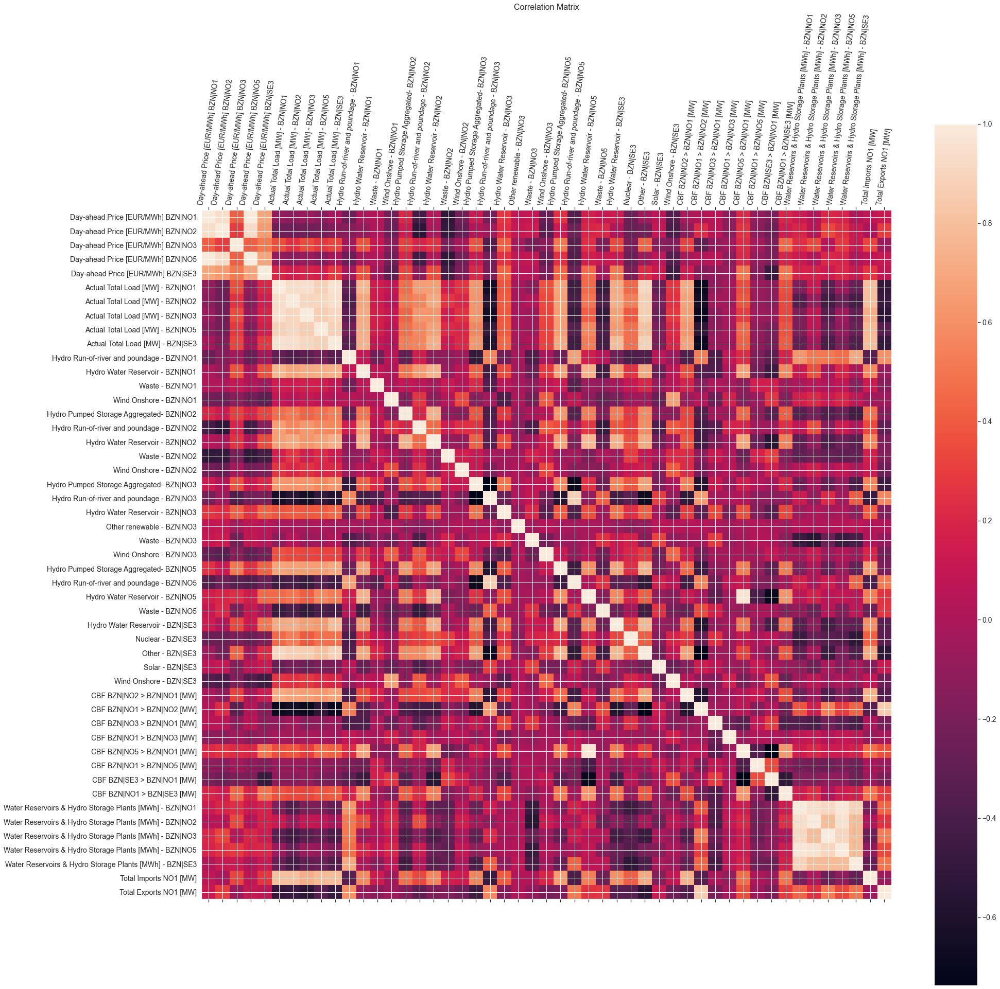

In [321]:
f = plt.figure(figsize=(30, 30))
plt.matshow(df_2022.corr(), fignum=f.number)
plt.xticks(range(df_2022.select_dtypes(['number']).shape[1]), df_2022.select_dtypes(['number']).columns, fontsize=14, rotation=83)
plt.yticks(range(df_2022.select_dtypes(['number']).shape[1]), df_2022.select_dtypes(['number']).columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

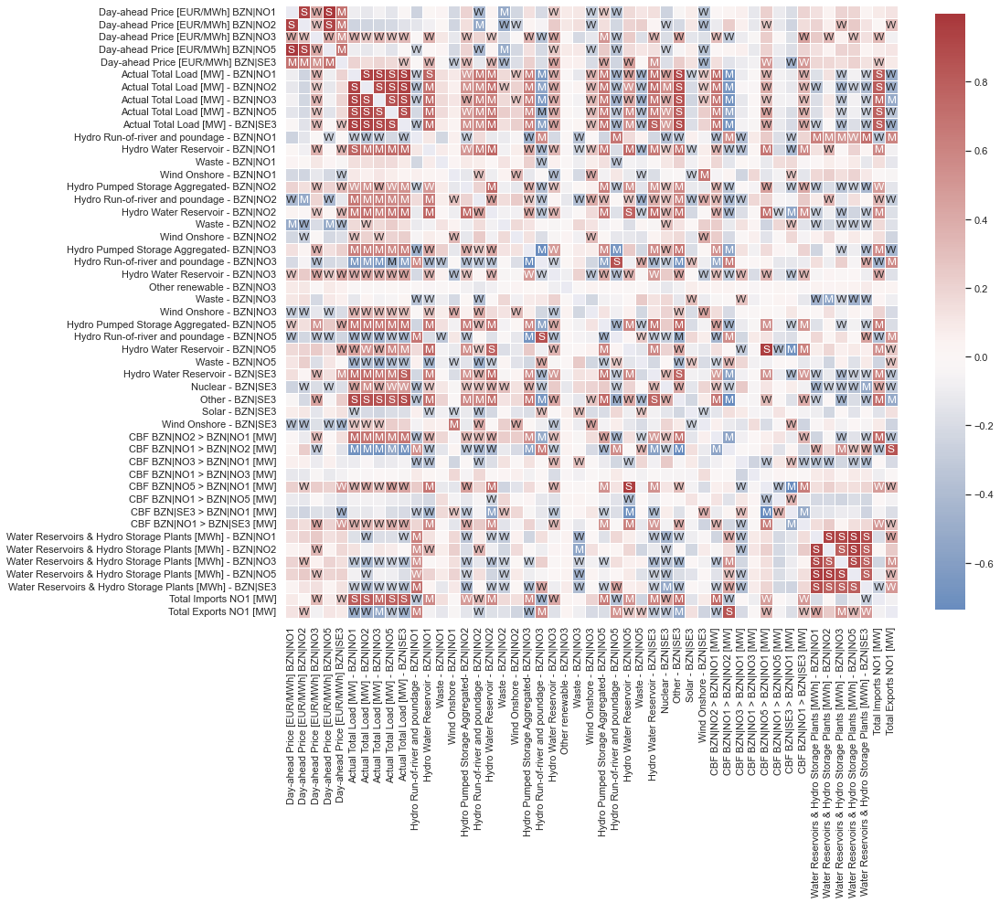

In [322]:
# Computes feature correlation
df_corr = df_2022.corr(method="pearson")

# Create labels for the correlation matrix
labels = np.where(np.abs(df_corr)>0.75, "S",
                  np.where(np.abs(df_corr)>0.5, "M",
                           np.where(np.abs(df_corr)>0.25, "W", "")))

# Plot correlation matrix
plt.figure(figsize=(15, 15))
sns.heatmap(df_corr, mask=np.eye(len(df_corr)), square=True,
            center=0, annot=labels, fmt='', linewidths=.5,
            cmap="vlag", cbar_kws={"shrink": 0.8});

## 4. Creating 4 dataframes from 56 features to study and analyse our data as categories.

### 4.1  Price Category

In [323]:
# Price category with 0 missing values
price_column_names = ['Day-ahead Price [EUR/MWh] BZN|NO1', 'Day-ahead Price [EUR/MWh] BZN|NO2', 'Day-ahead Price [EUR/MWh] BZN|NO3', 'Day-ahead Price [EUR/MWh] BZN|NO5', 'Day-ahead Price [EUR/MWh] BZN|SE3']
price_columns = df_2022[price_column_names]

df_2022.loc[:, price_column_names].isna().sum()

Day-ahead Price [EUR/MWh] BZN|NO1    0
Day-ahead Price [EUR/MWh] BZN|NO2    0
Day-ahead Price [EUR/MWh] BZN|NO3    0
Day-ahead Price [EUR/MWh] BZN|NO5    0
Day-ahead Price [EUR/MWh] BZN|SE3    0
dtype: int64

In [324]:
price_columns.describe()

,Day-ahead Price [EUR/MWh] BZN|NO1,Day-ahead Price [EUR/MWh] BZN|NO2,Day-ahead Price [EUR/MWh] BZN|NO3,Day-ahead Price [EUR/MWh] BZN|NO5,Day-ahead Price [EUR/MWh] BZN|SE3
count,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000
mean,192.510402,211.277426,41.938296,192.060664,129.200469
std,109.738988,125.849578,67.427388,109.260234,127.901438
min,0.040000,0.040000,-2.080000,0.040000,-2.080000
25%,131.042500,132.635000,11.600000,131.180000,27.090000
50%,168.925000,181.130000,16.905000,168.540000,94.120000
75%,214.822500,253.917500,45.415000,213.525000,187.372500
max,799.970000,844.000000,590.000000,799.970000,799.970000


In [325]:
# Finding hour with minimum price for NO1
price_NO1 = df_2022['Day-ahead Price [EUR/MWh] BZN|NO1']
min_row = df_2022[price_NO1 == price_NO1.min()]
min_row

,Day-ahead Price [EUR/MWh] BZN|NO1,Day-ahead Price [EUR/MWh] BZN|NO2,Day-ahead Price [EUR/MWh] BZN|NO3,Day-ahead Price [EUR/MWh] BZN|NO5,Day-ahead Price [EUR/MWh] BZN|SE3,Actual Total Load [MW] - BZN|NO1,Actual Total Load [MW] - BZN|NO2,Actual Total Load [MW] - BZN|NO3,Actual Total Load [MW] - BZN|NO5,Actual Total Load [MW] - BZN|SE3,...,CBF BZN|NO1 > BZN|NO5 [MW],CBF BZN|SE3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|SE3 [MW],Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO5,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3,Total Imports NO1 [MW],Total Exports NO1 [MW]
start MTU (UTC),,,,,,,,,,,,,,,,,,,,,
2022-11-11 03:00:00,0.04,0.04,-0.07,0.04,-0.07,2950.0,3378.0,2899.0,1576.0,7583,...,0.0,1094,0,5323211.0,25449076.0,7411170.0,15431832.0,1842000.0,1389.0,779.0


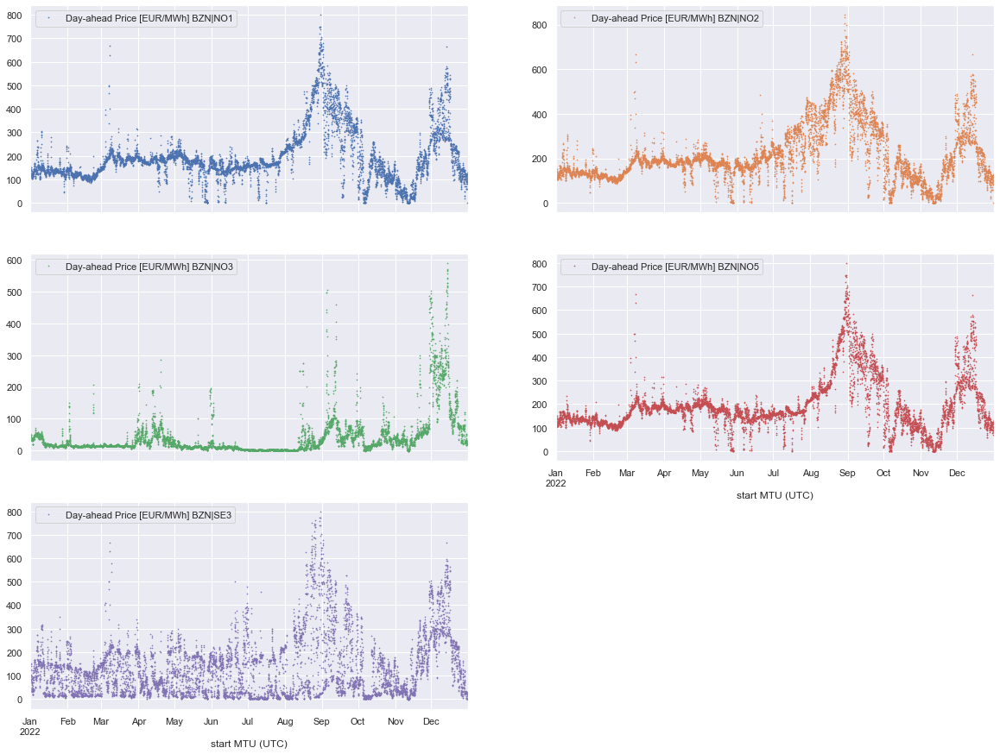

In [326]:
price_columns.plot(lw=0, marker=".", subplots=True, layout=(-1, 2),
                   figsize=(20, 15), markersize=1.3);

#### Feature distribution Price Category

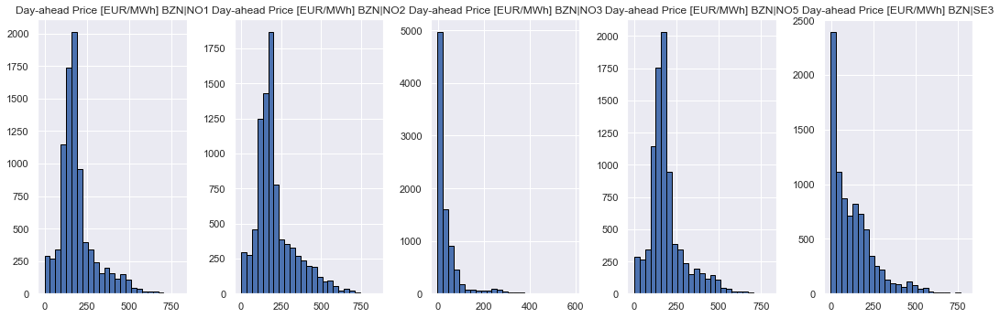

In [327]:
price_columns.hist(bins=25, figsize=(15, 5), layout=(-1, 5), edgecolor="black")
plt.tight_layout();

#### Feature Selection Price Category


#### Outliers Price Category
Outliers in our dataset occur due to volatility in marked and do not present experimental or human error.
Changing outliers values is necessary before analysing feature distribution and feature correlation. At the graph below we can wee the 10 days moving average in red color and day ahead price NO2 instances in white color. All the spikes outside the boundaries of 10 or 20 days moving average can create difficulty for our model since we rely on the short time for foresting the prices. We want to smooth the grapg by replacing the outlines with a given moving average.


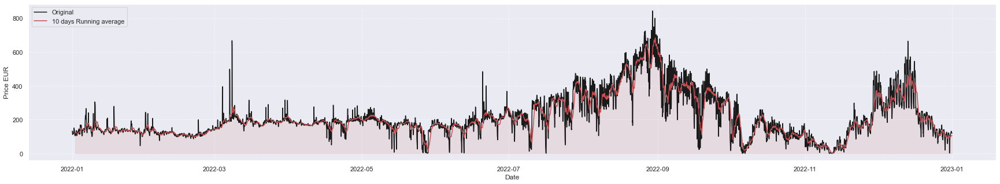

In [328]:
first_half =  df.loc[ '2022-01-01' : '2022-06-30']
second_half =  df.loc[ '2022-07-01' : '2022-12-31']


price_no2 = df_2022['Day-ahead Price [EUR/MWh] BZN|NO2']
price_no2_average = price_no2.rolling(window=30).mean()

plt.figure(figsize=(30, 5))


plt.plot(price_no2, 'k-', label='Original')
plt.plot(price_no2_average, 'r-', label='10 days Running average')
plt.ylabel('Price EUR')
plt.xlabel('Date')
plt.grid(linestyle=':')
plt.fill_between(price_no2_average.index, 0, price_no2_average, color='r', alpha=0.1)
plt.legend(loc='upper left')
plt.show()

### 4.2  Load Category

In [329]:
# Load category with 4 missing values
load_column_names = ['Actual Total Load [MW] - BZN|NO1','Actual Total Load [MW] - BZN|NO2',
                     'Actual Total Load [MW] - BZN|NO3','Actual Total Load [MW] - BZN|NO5', 'Actual Total Load [MW] - BZN|SE3']
load_columns = df_2022[load_column_names]

# Counts total NaN in load_columns = 4
load_columns.isnull().sum().sum()
load_columns.isna().sum()


Actual Total Load [MW] - BZN|NO1    0
Actual Total Load [MW] - BZN|NO2    0
Actual Total Load [MW] - BZN|NO3    0
Actual Total Load [MW] - BZN|NO5    0
Actual Total Load [MW] - BZN|SE3    0
dtype: int64

In [330]:
load_columns.describe()

,Actual Total Load [MW] - BZN|NO1,Actual Total Load [MW] - BZN|NO2,Actual Total Load [MW] - BZN|NO3,Actual Total Load [MW] - BZN|NO5,Actual Total Load [MW] - BZN|SE3
count,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000
mean,3711.929110,3985.057306,3179.632648,1878.106050,9575.168721
std,1174.433741,691.811619,459.275125,289.228203,2037.710339
min,1446.000000,1595.000000,2062.000000,1164.000000,5672.000000
25%,2741.000000,3436.000000,2812.000000,1660.000000,7912.750000
50%,3466.000000,3813.000000,3114.000000,1837.000000,9223.500000
75%,4671.000000,4542.000000,3541.250000,2087.000000,11114.750000
max,7011.000000,5988.000000,4432.000000,4326.000000,15486.000000


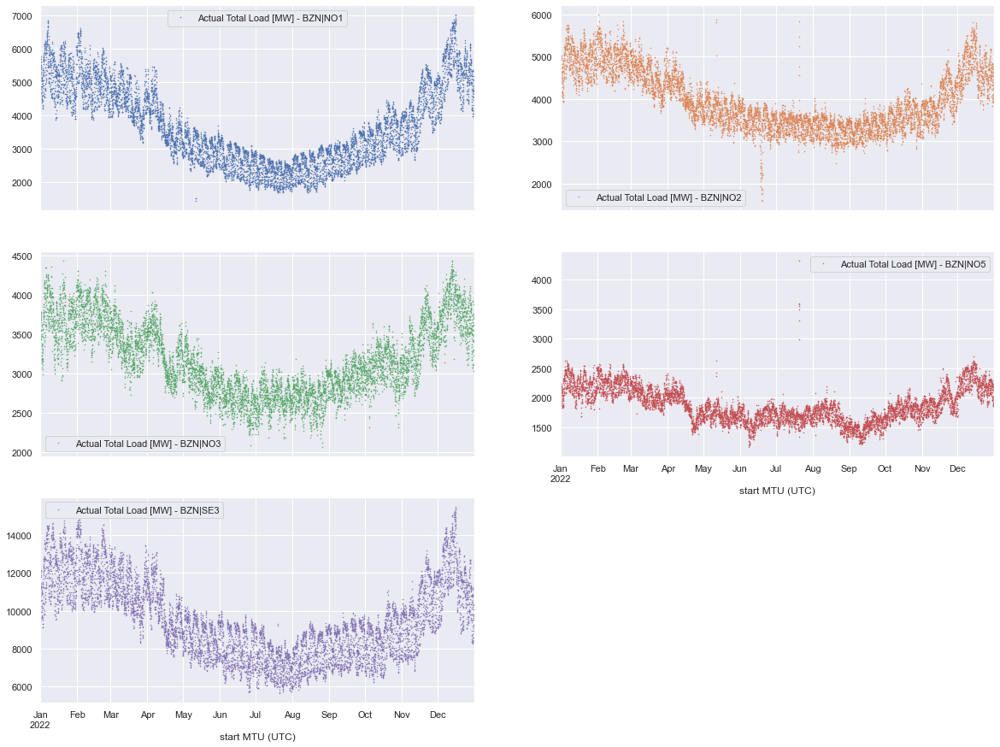

In [331]:
load_columns.plot(lw=0, marker=".", subplots=True, layout=(-1, 2),
                  figsize=(20, 15), markersize=1);

#### Feature distribution Laod Category

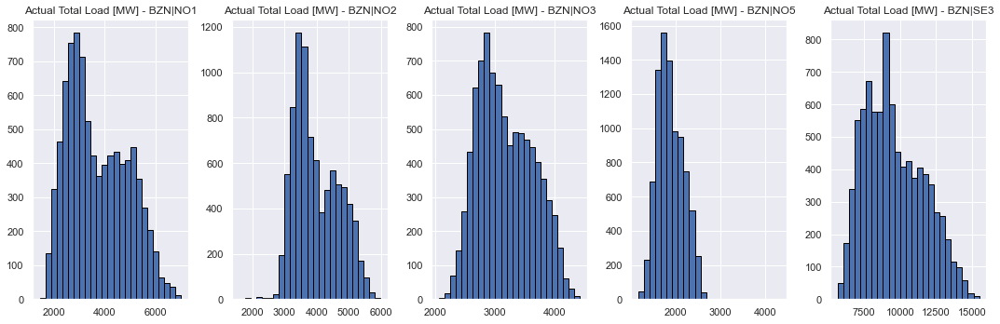

In [332]:
load_columns.hist(bins=25, figsize=(15, 5), layout=(-1, 5), edgecolor="black")
plt.tight_layout();

#### Feature Selection Laod Category

#### Outliers Price Category

### 4.3 Import & Export Category

In [333]:
# Import and export (CBF) category with 186 missing values
CBF_column_names = ['CBF BZN|NO2 > BZN|NO1 [MW]','CBF BZN|NO1 > BZN|NO2 [MW]',
                    'CBF BZN|NO3 > BZN|NO1 [MW]','CBF BZN|NO1 > BZN|NO3 [MW]',
                    'CBF BZN|NO5 > BZN|NO1 [MW]','CBF BZN|NO1 > BZN|NO5 [MW]',
                    'CBF BZN|SE3 > BZN|NO1 [MW]' , 'CBF BZN|NO1 > BZN|SE3 [MW]']
CBF_columns = df_2022[CBF_column_names]

# Counts total NaN in CBF_columns = 186
CBF_columns.isnull().sum().sum()

CBF_columns.isna().sum()

CBF BZN|NO2 > BZN|NO1 [MW]    0
CBF BZN|NO1 > BZN|NO2 [MW]    0
CBF BZN|NO3 > BZN|NO1 [MW]    0
CBF BZN|NO1 > BZN|NO3 [MW]    0
CBF BZN|NO5 > BZN|NO1 [MW]    0
CBF BZN|NO1 > BZN|NO5 [MW]    0
CBF BZN|SE3 > BZN|NO1 [MW]    0
CBF BZN|NO1 > BZN|SE3 [MW]    0
dtype: int64

In [334]:
CBF_columns.describe()

,CBF BZN|NO2 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|NO2 [MW],CBF BZN|NO3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|NO3 [MW],CBF BZN|NO5 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|NO5 [MW],CBF BZN|SE3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|SE3 [MW]
count,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000
mean,437.366667,539.234475,348.048174,1.393493,1235.515753,26.089840,599.958562,178.111530
std,627.777701,676.148918,143.545291,13.756675,823.543581,109.161657,581.845746,361.792681
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,263.000000,0.000000,562.750000,0.000000,0.000000,0.000000
50%,0.000000,63.500000,349.000000,0.000000,1222.000000,0.000000,483.000000,0.000000
75%,785.250000,1156.000000,435.000000,0.000000,1835.250000,0.000000,1034.000000,128.000000
max,3363.000000,2423.000000,786.000000,377.000000,3476.000000,1052.000000,2520.000000,2155.000000


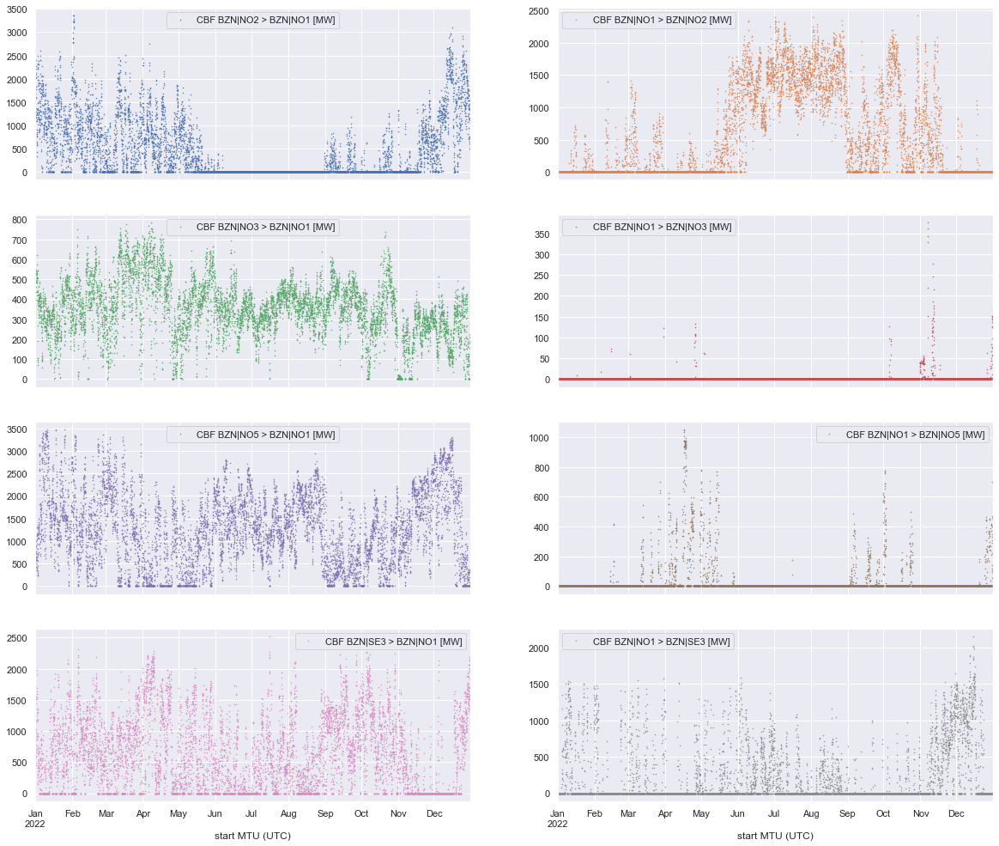

In [335]:
CBF_columns.plot(lw=0, marker=".", subplots=True, layout=(-1, 2),
                 figsize=(20, 17), markersize=1);

#### Feature distribution Import & Export Category

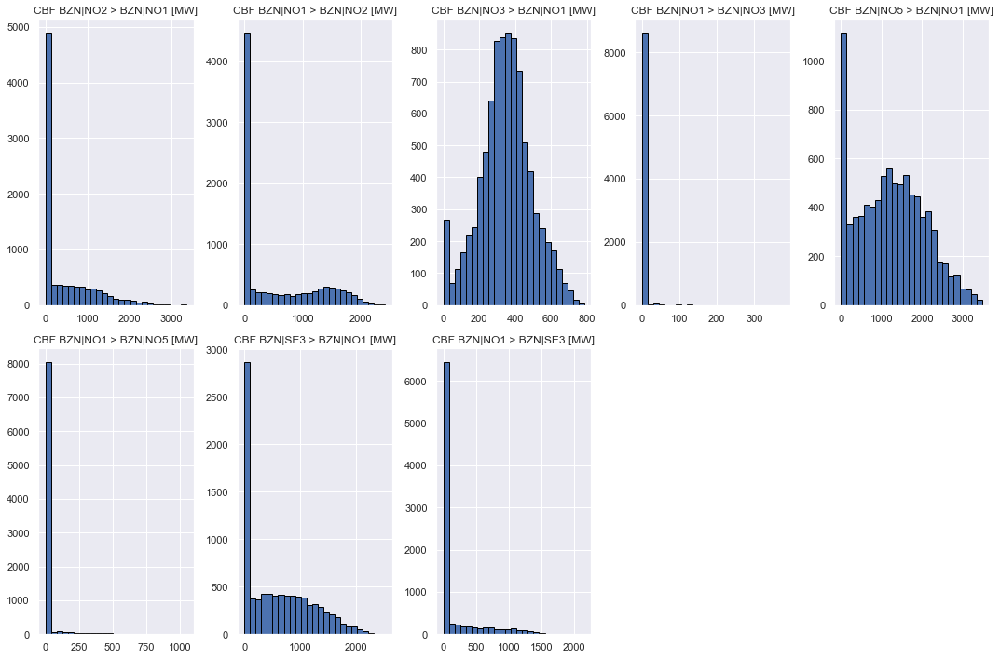

In [336]:
CBF_columns.hist(bins=25, figsize=(15, 10), layout=(-1, 5), edgecolor="black")
plt.tight_layout();

### Total Import & Export NO1 Category (CREATED FEATURES)

Text(0.5, 0, 'Time [h]')

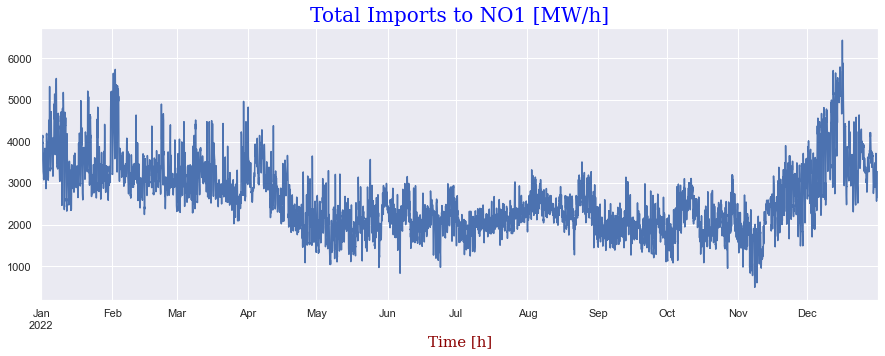

In [337]:
# Plotting 'Total Import to NO1'
total_import_NO1.plot(subplots=True, x='start MTU (UTC)', figsize=(15, 5))
font1 = {'family':'serif','color':'blue','size':20}
font2 = {'family':'serif','color':'darkred','size':15}
plt.title("Total Imports to NO1 [MW/h]", fontdict = font1)
plt.xlabel("Time [h]", fontdict = font2)

Text(0, 0.5, 'Electricity imported [MW]')

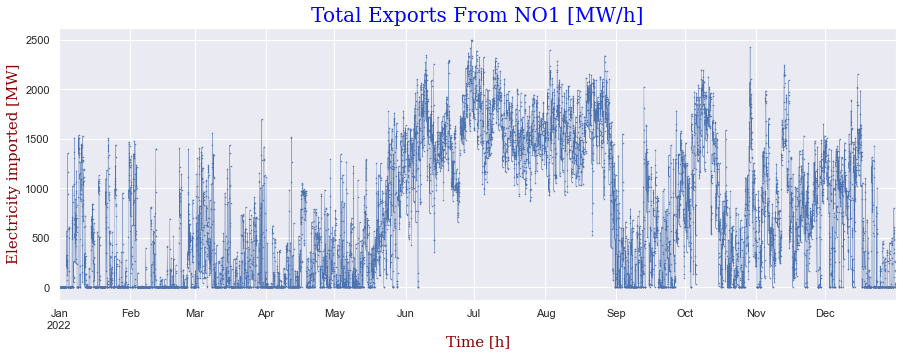

In [338]:
## Plotting the new feature 'Total Exports NO1 [MW/h]'
total_export_nor.plot(lw=0.3, marker=".",
                      figsize=(15, 5), markersize=1)
font1 = {'family':'serif','color':'blue','size':20}
font2 = {'family':'serif','color':'darkred','size':15}
plt.title("Total Exports From NO1 [MW/h]", fontdict = font1)
plt.xlabel("Time [h]", fontdict = font2)
plt.ylabel("Electricity imported [MW]", fontdict = font2)

In [339]:
# Import and export (CBF) category with 186 missing values
total_import_export_NO1 = df_2022[['Total Imports NO1 [MW]', 'Total Exports NO1 [MW]']]

# There are not any 0's in total 2022 imports NO1
df_2022['Total Imports NO1 [MW]'].where(df_2022['Total Imports NO1 [MW]'] == 0).count()



# There are 2132 0's which make up for 0.24 of 'Total Exports NO1'. 385 of them are NaN.
df_2022['Total Exports NO1 [MW]'].where(df_2022['Total Exports NO1 [MW]'] == 0).count()
df_2022['Total Exports NO1 [MW]'].where(df_2022['Total Exports NO1 [MW]'] == 0).count()/ df_2022.shape[0]


0.24337899543378996

In [340]:
total_import_export_NO1.describe()

,Total Imports NO1 [MW],Total Exports NO1 [MW]
count,8760.000000,8760.000000
mean,2620.889155,744.829338
std,817.658950,678.107267
min,497.000000,0.000000
25%,2035.000000,15.000000
50%,2467.500000,613.000000
75%,3103.250000,1344.250000
max,6434.000000,2495.000000


#### Feature distribution Total Import & Export NO1 Category


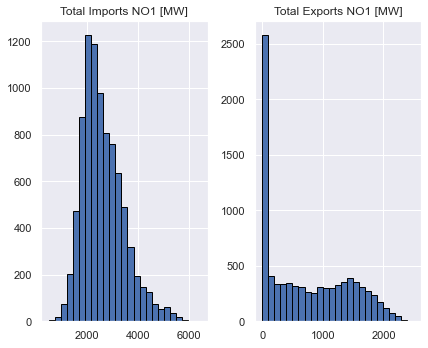

In [341]:
total_import_export_NO1.hist(bins=25, figsize=(15, 5), layout=(-1, 5), edgecolor="black")
plt.tight_layout();

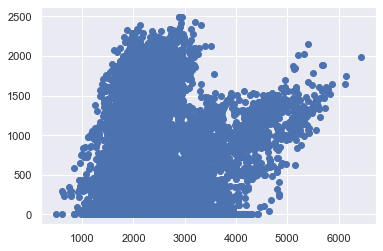

In [342]:
plt.scatter(df_2022['Total Imports NO1 [MW]'], df_2022['Total Exports NO1 [MW]'] )
plt.show()

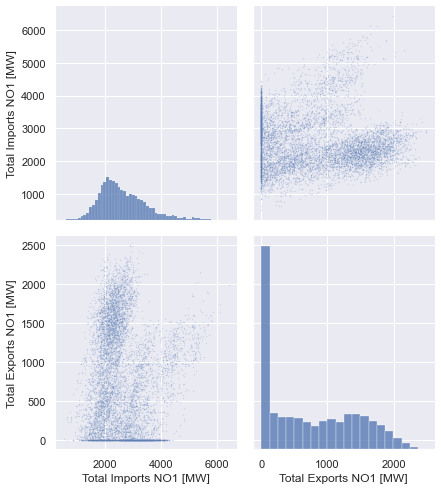

In [343]:
plt.show()
data = df_2022[['Total Imports NO1 [MW]', 'Total Exports NO1 [MW]']]
data
# Pair plot for imports and exports
# The main-diagonal subplots are the univariate histograms (distributions) for each attribute.
sns.set(font_scale = 1)
fig = sns.pairplot( data, height=1.5, plot_kws={"s": 2, "alpha": 0.2} );
fig.fig.set_size_inches(8,8)

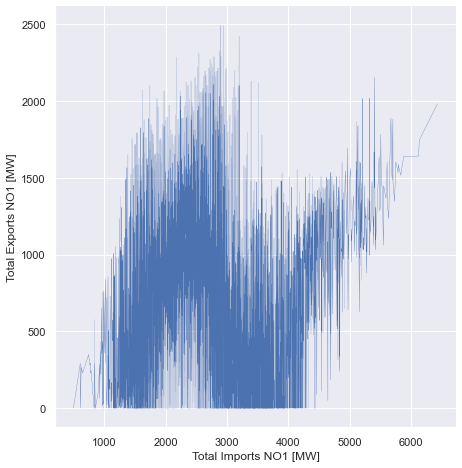

In [344]:
fig = sns.relplot(data=data, x="Total Imports NO1 [MW]", y="Total Exports NO1 [MW]", kind="line", lw=0.3)
fig.fig.set_size_inches(7,7)

#### Feature Correlation Import & Export Category


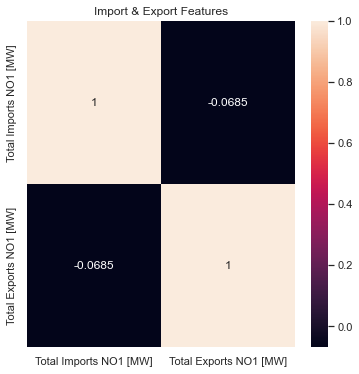

In [345]:
plt.figure(figsize=(6, 6))
df_corr = total_import_export_NO1.corr()
sns.heatmap(df_corr, annot=True, fmt='.3g')
plt.title("Import & Export Features")
plt.show()

#### Outliers Import & Export Category

### 4. 4 Electricity generation per unit Category

Total Generation per unit type [MW]:
>Fossil Gas
>Nuclear (SE3)Waste (NO1,NO2,NO3,NO5)
>Wind Onshore (NO2,NO3,NO5,SE3)
         Hydro Pumped Storage (NO2,NO3,NO5)
         Hydro Run-of-river And Poundage (NO1,NO2,NO3,NO5)
         Other (NO1,NO2,NO3,NO5,SE3)
         Other Renewable (NO3)
         Hydro Water Reservoir ( NO1, NO2, NO3, NO5, SE3)
         Total Electricity Generation NO1 (Created Feature)
         Total Electricity Generation NO2 (Created Feature)
         Total Electricity Generation NO3 (Created Feature)
         Total Electricity Generation NO5 (Created Feature)
         Total Electricity Generation SE3 (Created Feature)

In [346]:
# Generation per unit type category with 174 missing values
## sone5 no wind, sone SE3 no waaste and only with nuclear
generation_names = [

                    'Hydro Run-of-river and poundage - BZN|NO1', 'Hydro Run-of-river and poundage - BZN|NO2', 'Hydro Run-of-river and poundage - BZN|NO3', 'Hydro Run-of-river and poundage - BZN|NO5',

                    'Wind Onshore - BZN|NO1', 'Wind Onshore - BZN|NO2', 'Wind Onshore - BZN|NO3', 'Wind Onshore - BZN|SE3', 'Waste - BZN|NO1', 'Waste - BZN|NO2', 'Waste - BZN|NO3',
                    'Waste - BZN|NO5',  'Solar - BZN|SE3', 'Nuclear - BZN|SE3', 'Other - BZN|SE3',

                    'Hydro Pumped Storage Aggregated- BZN|NO2', 'Hydro Pumped Storage Aggregated- BZN|NO3', 'Hydro Pumped Storage Aggregated- BZN|NO5',
                    'Other renewable - BZN|NO3',

                    'Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1', 'Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2', 'Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3', 'Water Reservoirs & ''Hydro Storage Plants [MWh] - BZN|NO5','Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3',

                   'Hydro Water Reservoir - BZN|NO1','Hydro Water Reservoir - BZN|NO2',
                   'Hydro Water Reservoir - BZN|NO3','Hydro Water Reservoir - BZN|NO5',
                   'Hydro Water Reservoir - BZN|SE3'

                    ]
generation_columns = df_2022[generation_names]

# Counts total NaN in Generation_columns = 174
generation_columns.isnull().sum().sum()
generation_columns.isna().sum()



Hydro Run-of-river and poundage - BZN|NO1                  0
Hydro Run-of-river and poundage - BZN|NO2                  0
Hydro Run-of-river and poundage - BZN|NO3                  0
Hydro Run-of-river and poundage - BZN|NO5                  0
Wind Onshore - BZN|NO1                                     0
Wind Onshore - BZN|NO2                                     0
Wind Onshore - BZN|NO3                                     0
Wind Onshore - BZN|SE3                                     1
Waste - BZN|NO1                                            0
Waste - BZN|NO2                                            0
Waste - BZN|NO3                                            0
Waste - BZN|NO5                                            0
Solar - BZN|SE3                                            1
Nuclear - BZN|SE3                                          1
Other - BZN|SE3                                            1
Hydro Pumped Storage Aggregated- BZN|NO2                   0
Hydro Pumped Storage Agg

In [347]:
generation_columns.describe()

,Hydro Run-of-river and poundage - BZN|NO1,Hydro Run-of-river and poundage - BZN|NO2,Hydro Run-of-river and poundage - BZN|NO3,Hydro Run-of-river and poundage - BZN|NO5,Wind Onshore - BZN|NO1,Wind Onshore - BZN|NO2,Wind Onshore - BZN|NO3,Wind Onshore - BZN|SE3,Waste - BZN|NO1,Waste - BZN|NO2,...,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO5,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3,Hydro Water Reservoir - BZN|NO1,Hydro Water Reservoir - BZN|NO2,Hydro Water Reservoir - BZN|NO3,Hydro Water Reservoir - BZN|NO5,Hydro Water Reservoir - BZN|SE3
count,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8760.000000,8759.000000,8760.000000,8760.000000,...,8.760000e+03,8.760000e+03,8.760000e+03,8.760000e+03,8.760000e+03,8760.000000,8760.000000,8760.000000,8760.000000,8759.000000
mean,1209.284247,555.648858,537.426598,248.444178,94.691210,550.605594,748.882648,971.454846,4.715411,6.248630,...,3.104524e+06,1.553699e+07,5.547357e+06,8.777882e+06,1.437907e+06,486.920205,3690.243265,1882.301712,2791.217466,832.950793
std,311.740760,207.884296,244.993969,151.873297,79.292481,397.487945,499.317320,686.052356,2.390364,3.345065,...,1.519288e+06,5.390880e+06,2.081847e+06,4.407063e+06,2.752389e+05,323.843231,2104.571338,488.554625,1166.571109,358.669778
min,591.000000,169.000000,144.000000,17.000000,0.000000,1.000000,9.000000,35.000000,0.000000,0.000000,...,4.853340e+05,6.334677e+06,1.844130e+06,1.624537e+06,8.330000e+05,58.000000,221.000000,293.000000,297.000000,94.000000
25%,976.000000,379.000000,319.000000,126.000000,28.000000,193.000000,312.000000,409.000000,3.000000,4.000000,...,1.812166e+06,1.167022e+07,3.909162e+06,4.719615e+06,1.268000e+06,201.000000,1908.000000,1551.000000,1892.000000,547.500000
50%,1140.000000,555.000000,501.000000,203.000000,75.000000,472.500000,633.000000,832.000000,4.000000,5.000000,...,3.900786e+06,1.621454e+07,5.665552e+06,9.428249e+06,1.546000e+06,417.000000,3540.000000,1921.000000,2792.000000,806.000000
75%,1468.000000,720.000000,717.250000,377.000000,151.000000,909.250000,1178.250000,1394.000000,6.000000,9.000000,...,4.108040e+06,1.802379e+07,7.498030e+06,1.225761e+07,1.629000e+06,717.000000,5184.000000,2225.000000,3622.000000,1103.000000
max,1895.000000,1146.000000,1095.000000,630.000000,355.000000,1337.000000,1997.000000,2945.000000,26.000000,16.000000,...,5.323211e+06,2.544908e+07,8.100718e+06,1.543183e+07,1.853000e+06,1283.000000,8664.000000,2997.000000,6107.000000,1873.000000


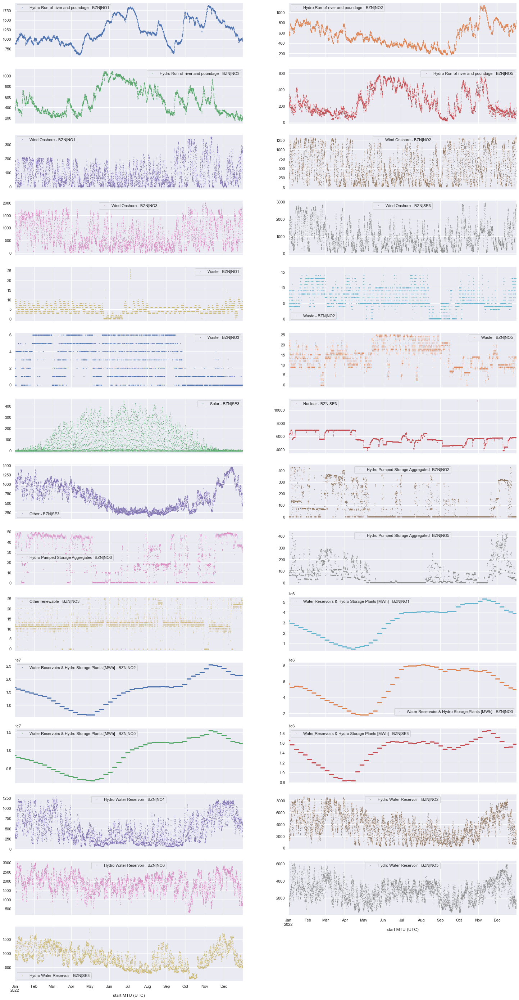

In [348]:
generation_columns.plot(lw=0, marker=".", subplots=True, layout=(-1, 2),
                        figsize=(25, 50), markersize=1);

#### Creating total electricity generation feature (Feature engineering)

In [349]:
NO1_generation_columns_without_water_reservoir = df_2022[[
    'Wind Onshore - BZN|NO1',
    'Waste - BZN|NO1']]

NO1_generation_columns_without_water_reservoir = df_2022[['Hydro Run-of-river and poundage - BZN|NO1',
                                                          'Wind Onshore - BZN|NO1',
                                                          'Waste - BZN|NO1',
                                                          'Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1']]

## Creating Total generation NO1 using .sum()
total_generation_NO1 = NO1_generation_columns_without_water_reservoir.sum(axis = 1)

# Adding the new feature to our 2022 dataframe
df_2022['Total Eelectricity Generation NO1 [MW]'] = total_generation_NO1
df_2022

C:\Users\Isak\AppData\Local\Temp\ipykernel_44424\2235046088.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2022['Total Eelectricity Generation NO1 [MW]'] = total_generation_NO1


,Day-ahead Price [EUR/MWh] BZN|NO1,Day-ahead Price [EUR/MWh] BZN|NO2,Day-ahead Price [EUR/MWh] BZN|NO3,Day-ahead Price [EUR/MWh] BZN|NO5,Day-ahead Price [EUR/MWh] BZN|SE3,Actual Total Load [MW] - BZN|NO1,Actual Total Load [MW] - BZN|NO2,Actual Total Load [MW] - BZN|NO3,Actual Total Load [MW] - BZN|NO5,Actual Total Load [MW] - BZN|SE3,...,CBF BZN|SE3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|SE3 [MW],Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO5,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3,Total Imports NO1 [MW],Total Exports NO1 [MW],Total Eelectricity Generation NO1 [MW]
start MTU (UTC),,,,,,,,,,,,,,,,,,,,,
2022-01-01 00:00:00,129.30,129.30,41.33,129.30,41.33,4701.0,4440.0,3463.0,1991.0,9612,...,1065,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3272.0,0.0,3205332.0
2022-01-01 01:00:00,132.08,132.08,42.18,132.08,42.18,4681.0,4480.0,3388.0,1969.0,9601,...,927,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3208.0,0.0,3205330.0
2022-01-01 02:00:00,111.44,111.44,44.37,111.44,44.37,4620.0,4424.0,3387.0,1911.0,9552,...,748,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3225.0,0.0,3205327.0
2022-01-01 03:00:00,112.35,112.35,37.67,112.35,37.67,4645.0,4386.0,3376.0,1996.0,9449,...,918,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3255.0,0.0,3205320.0
2022-01-01 04:00:00,113.90,113.90,39.70,113.90,39.70,4670.0,4375.0,3427.0,1953.0,9614,...,826,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3274.0,0.0,3205321.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,123.61,123.61,23.82,123.61,11.57,4650.0,4333.0,3612.0,2128.0,9602,...,2083,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2893.0,0.0,3916522.0
2022-12-31 20:00:00,121.09,121.09,23.93,121.09,14.89,4573.0,4270.0,3605.0,2089.0,9251,...,2097,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2840.0,0.0,3916491.0
2022-12-31 21:00:00,120.00,120.00,23.75,120.00,9.94,4453.0,4294.0,3479.0,2037.0,9092,...,2007,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2747.0,0.0,3916503.0


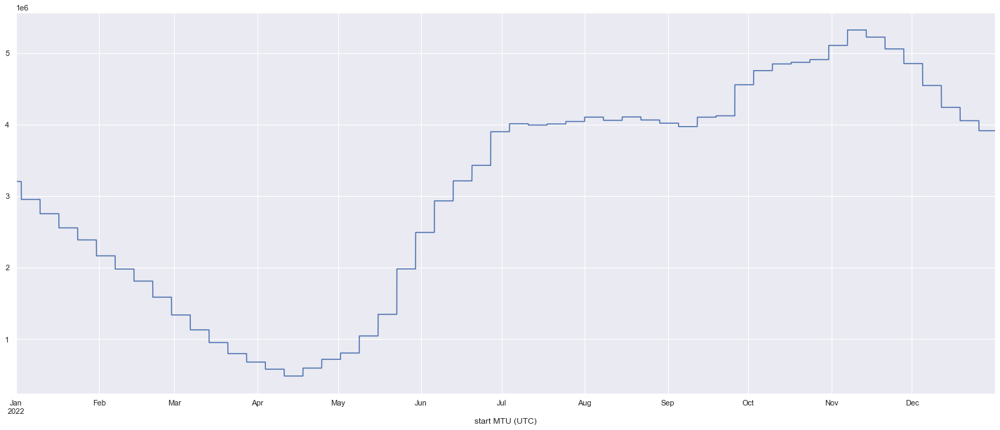

In [350]:
# total_generation_NO1.plot(lw=0, marker=".", figsize=(25, 10), markersize=1);

total_generation_NO1.plot(figsize=(25, 10), markersize=1);

#### Feature distribution  Electrivity genration per unit Category

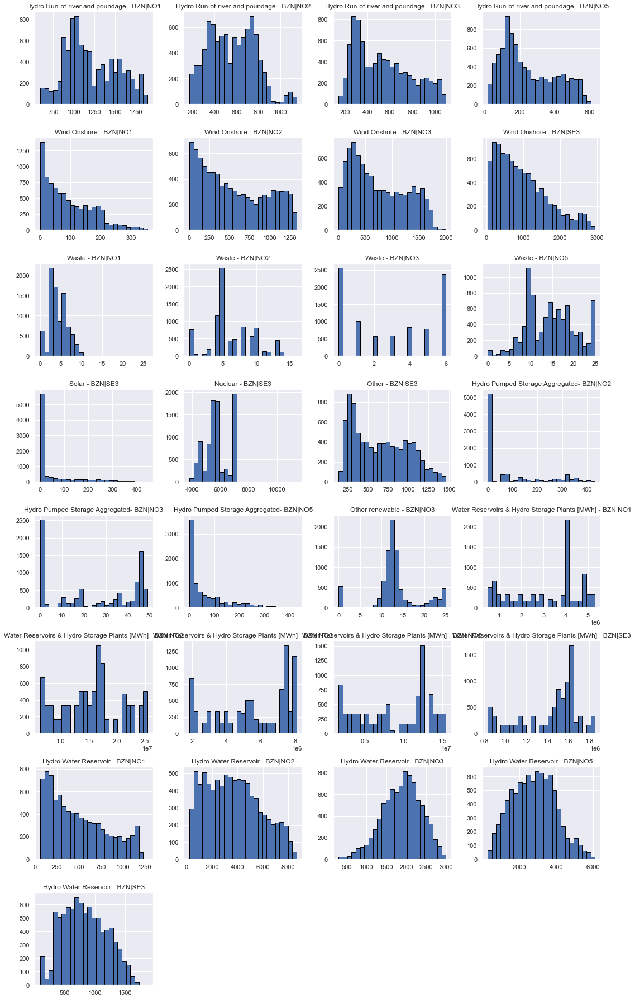

In [351]:
generation_columns.hist(bins=25, figsize=(15, 25), layout=(-1, 4), edgecolor="black")
plt.tight_layout();

#### Feature Correlation Electricity Generation Category

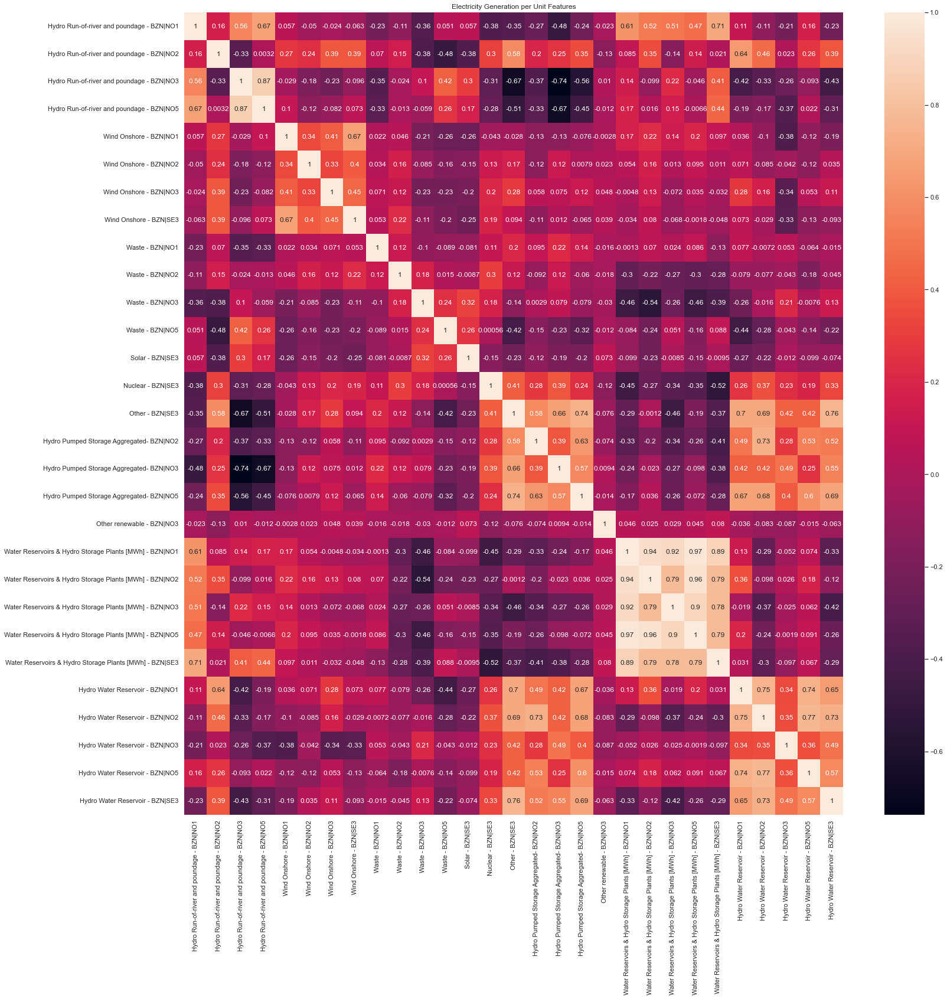

In [352]:
plt.figure(figsize=(25, 25))
df_corr = generation_columns.corr()
sns.heatmap(df_corr, annot=True, fmt='.2g')
plt.title("Electricity Generation per Unit Features")
plt.show()

C:\Users\Isak\AppData\Local\Temp\ipykernel_44424\1847032420.py:5: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  cb = plt.colorbar()


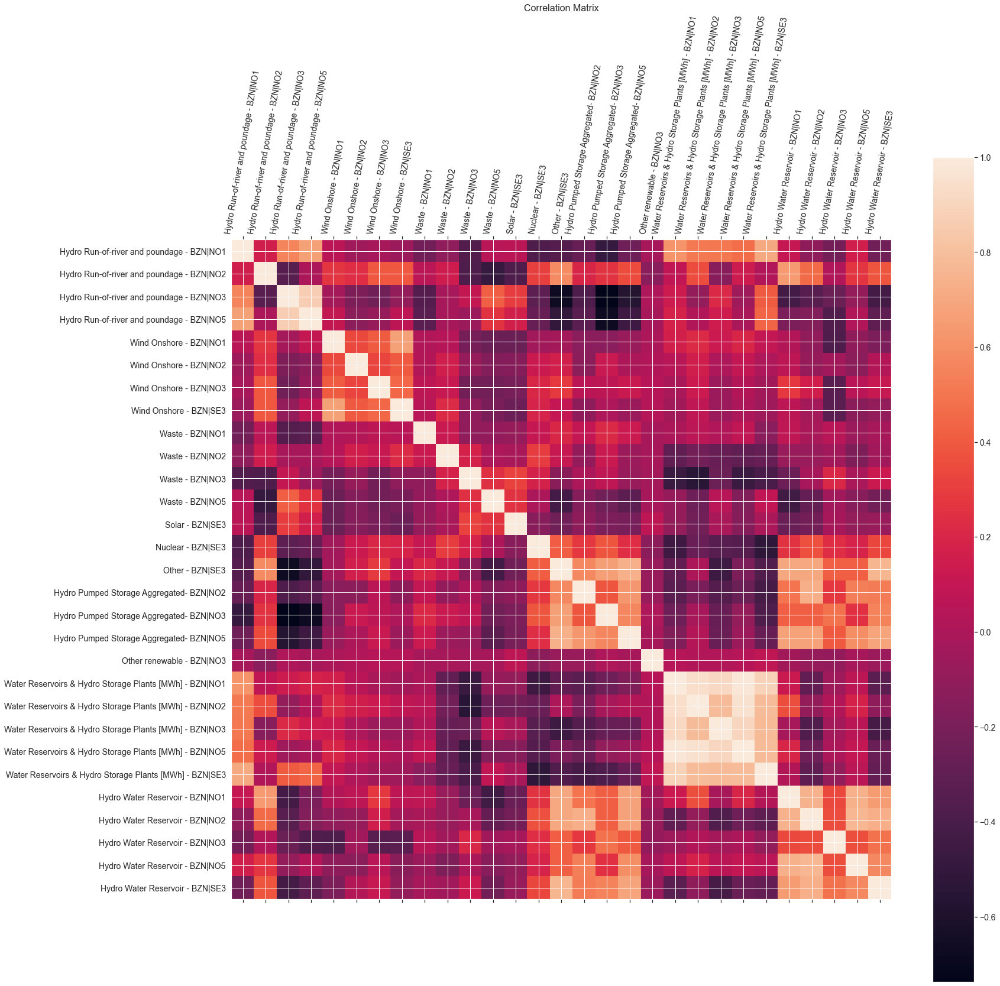

In [353]:
f = plt.figure(figsize=(25, 25))
plt.matshow(generation_columns.corr(), fignum=f.number)
plt.xticks(range(generation_columns.select_dtypes(['number']).shape[1]), generation_columns.select_dtypes(['number']).columns, fontsize=14, rotation=80)
plt.yticks(range(generation_columns.select_dtypes(['number']).shape[1]), generation_columns.select_dtypes(['number']).columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

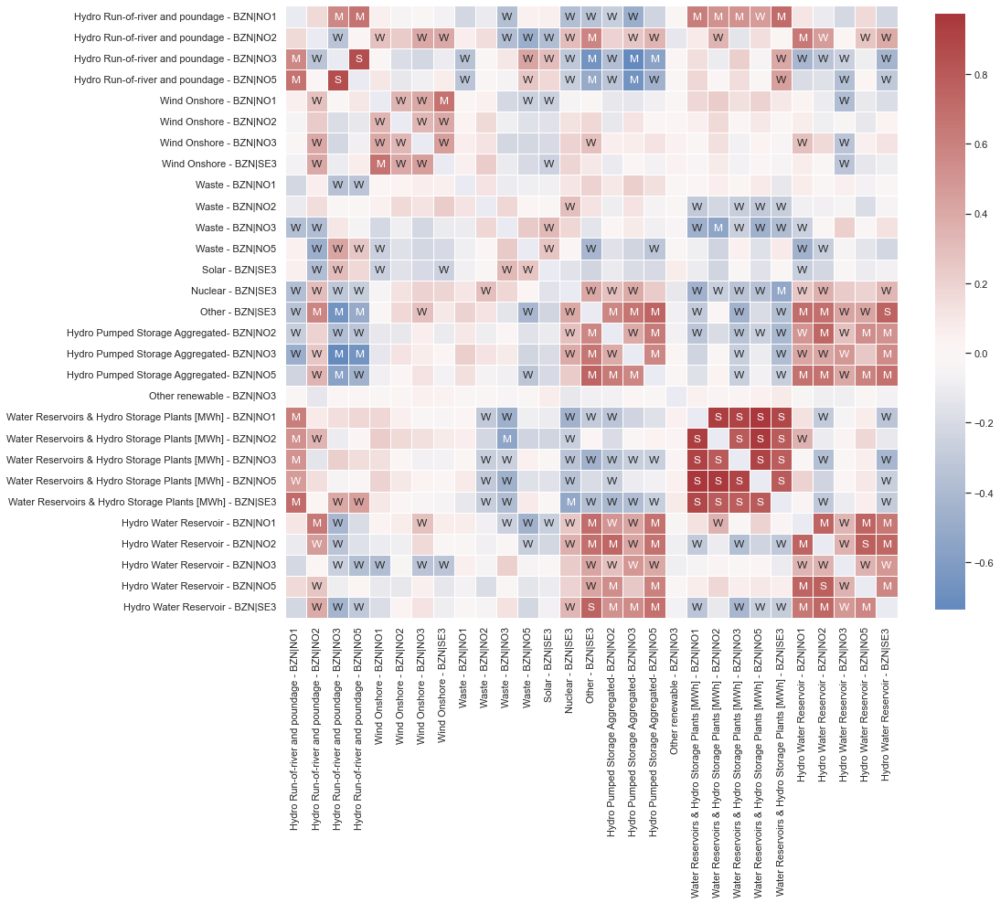

In [354]:
# Computes feature correlation
df_corr = generation_columns.corr(method="pearson")

# Create labels for the correlation matrix
labels = np.where(np.abs(df_corr)>0.75, "S",
                  np.where(np.abs(df_corr)>0.5, "M",
                           np.where(np.abs(df_corr)>0.25, "W", "")))

# Plot correlation matrix
plt.figure(figsize=(15, 15))
sns.heatmap(df_corr, mask=np.eye(len(df_corr)), square=True,
            center=0, annot=labels, fmt='', linewidths=.5,
            cmap="vlag", cbar_kws={"shrink": 0.8});

#### Outliers Electricity Generation Category

#### Correlation between all 4 categories in NO1

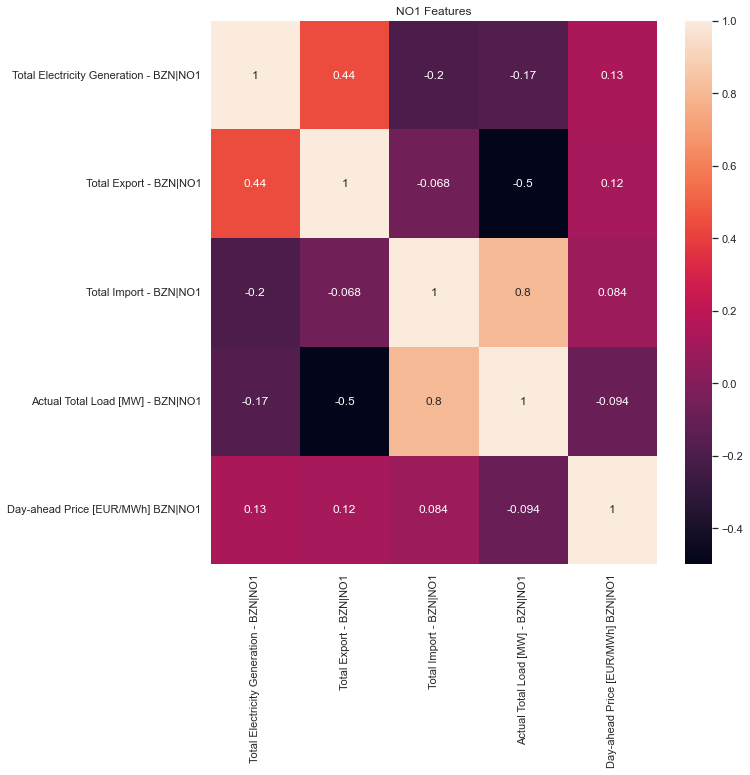

In [355]:
all_NO1_features_price_excluded = pd.DataFrame()
all_NO1_features_price_included = pd.DataFrame()

total_load_NO1 = df_2022['Actual Total Load [MW] - BZN|NO1']
day_ahead_price_NO1 = df_2022['Day-ahead Price [EUR/MWh] BZN|NO1']

all_NO1_features_price_excluded ['Total Electricity Generation - BZN|NO1'] = total_generation_NO1
all_NO1_features_price_excluded ['Total Export - BZN|NO1'] = total_export_NO1
all_NO1_features_price_excluded ['Total Import - BZN|NO1'] = total_import_NO1
all_NO1_features_price_excluded ['Actual Total Load [MW] - BZN|NO1'] = total_load_NO1


all_NO1_features_price_included = all_NO1_features_price_excluded
all_NO1_features_price_included ['Day-ahead Price [EUR/MWh] BZN|NO1'] = day_ahead_price_NO1


plt.figure(figsize=(10, 10))
df_corr = all_NO1_features_price_excluded.corr()
sns.heatmap(df_corr, annot=True, fmt='.2g')
plt.title("NO1 Features")
plt.show()

<Figure size 432x288 with 0 Axes>

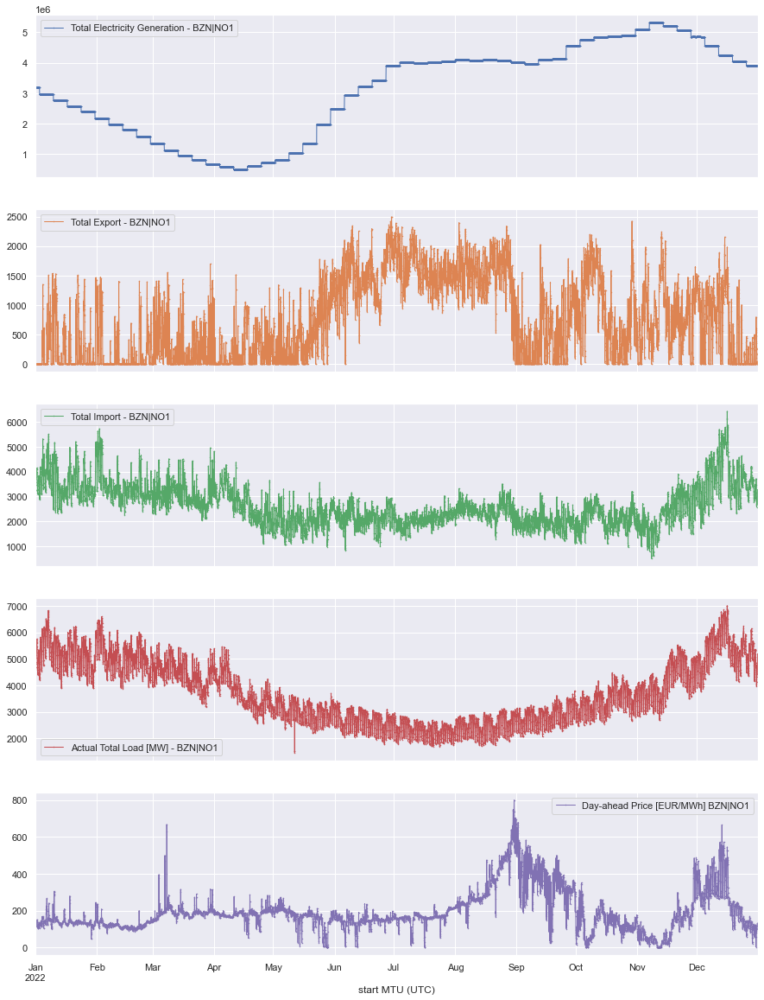

<Figure size 432x288 with 0 Axes>

In [356]:
all_NO1_features_price_included.plot(lw=1, marker=".", subplots=True, layout=(-1, 1),
                        figsize=(15, 20), markersize=1);
plt.figure()

#### Outliers Electricity Generation Category

### Principal Component Analysis
PCA is just a transformation of our data and attempts to find out what features explain the most variance in our data. In our dataset we have 50 dimensional data, and it is really difficult to describe high dimensional data. We want to find principal components.

In [357]:
from sklearn.preprocessing import StandardScaler

# PCA does not accept missing values encoded as NaN natively.
df_2022.replace(np. nan,0, inplace = True)
# scale the data to the range between 0 and 1 before using PCA
scaler = StandardScaler()
scaler.fit(df_2022)

scaled_data = scaler.fit_transform(df_2022)
scaled_data
df_2022


C:\Users\Isak\AppData\Local\Temp\ipykernel_44424\681155001.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2022.replace(np. nan,0, inplace = True)


,Day-ahead Price [EUR/MWh] BZN|NO1,Day-ahead Price [EUR/MWh] BZN|NO2,Day-ahead Price [EUR/MWh] BZN|NO3,Day-ahead Price [EUR/MWh] BZN|NO5,Day-ahead Price [EUR/MWh] BZN|SE3,Actual Total Load [MW] - BZN|NO1,Actual Total Load [MW] - BZN|NO2,Actual Total Load [MW] - BZN|NO3,Actual Total Load [MW] - BZN|NO5,Actual Total Load [MW] - BZN|SE3,...,CBF BZN|SE3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|SE3 [MW],Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO5,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3,Total Imports NO1 [MW],Total Exports NO1 [MW],Total Eelectricity Generation NO1 [MW]
start MTU (UTC),,,,,,,,,,,,,,,,,,,,,
2022-01-01 00:00:00,129.30,129.30,41.33,129.30,41.33,4701.0,4440.0,3463.0,1991.0,9612,...,1065,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3272.0,0.0,3205332.0
2022-01-01 01:00:00,132.08,132.08,42.18,132.08,42.18,4681.0,4480.0,3388.0,1969.0,9601,...,927,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3208.0,0.0,3205330.0
2022-01-01 02:00:00,111.44,111.44,44.37,111.44,44.37,4620.0,4424.0,3387.0,1911.0,9552,...,748,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3225.0,0.0,3205327.0
2022-01-01 03:00:00,112.35,112.35,37.67,112.35,37.67,4645.0,4386.0,3376.0,1996.0,9449,...,918,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3255.0,0.0,3205320.0
2022-01-01 04:00:00,113.90,113.90,39.70,113.90,39.70,4670.0,4375.0,3427.0,1953.0,9614,...,826,0,3204274.0,16810140.0,5688093.0,8631916.0,1656000.0,3274.0,0.0,3205321.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,123.61,123.61,23.82,123.61,11.57,4650.0,4333.0,3612.0,2128.0,9602,...,2083,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2893.0,0.0,3916522.0
2022-12-31 20:00:00,121.09,121.09,23.93,121.09,14.89,4573.0,4270.0,3605.0,2089.0,9251,...,2097,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2840.0,0.0,3916491.0
2022-12-31 21:00:00,120.00,120.00,23.75,120.00,9.94,4453.0,4294.0,3479.0,2037.0,9092,...,2007,0,3915448.0,21384042.0,5038234.0,12014136.0,1579000.0,2747.0,0.0,3916503.0


In [358]:
## Instantiate a PCA object and find the PC's using fit method
from sklearn.decomposition import PCA

pca = PCA(n_components=0.95)
pca.fit(scaled_data)
pca_result = pca.transform(scaled_data)

#### Interpretation of the Principal Components
To interpret each component, we must compute the correlations between the original data and each principal component. We use the correlations between the principal components and the original feature values to interpret these principal components. Because of standardization, all principal components will have mean 0. Interpretation of the principal components is based on finding which variables are most strongly correlated with each component, i.e., which of these numbers are large in magnitude, the farthest from zero in either direction. Highest correlation values we have is 0.26 which is not very helpfully to explain the relationship between principal components and the original feature values.


In [359]:
pca.components_

array([[ 0.00759106, -0.03104012,  0.10229004, ...,  0.21001995,
        -0.13398547, -0.0993548 ],
       [ 0.14084125,  0.15482134,  0.16248889, ...,  0.04191944,
         0.1762209 ,  0.28201421],
       [-0.29537226, -0.29953756, -0.0750391 , ..., -0.0066747 ,
        -0.04368436,  0.1373777 ],
       ...,
       [-0.01723457, -0.09631139, -0.01103305, ...,  0.06568992,
         0.02854097,  0.03838884],
       [ 0.01312074, -0.04174128, -0.31962839, ..., -0.05003685,
         0.039365  , -0.03738728],
       [-0.09745453, -0.10202999, -0.16428274, ...,  0.11953043,
        -0.14242234,  0.0293087 ]])

In [360]:
#Tring to use a heatmap to understand what each of these PC's represents
df_comp = pd.DataFrame(pca.components_, columns=df_2022.columns )
df_comp

,Day-ahead Price [EUR/MWh] BZN|NO1,Day-ahead Price [EUR/MWh] BZN|NO2,Day-ahead Price [EUR/MWh] BZN|NO3,Day-ahead Price [EUR/MWh] BZN|NO5,Day-ahead Price [EUR/MWh] BZN|SE3,Actual Total Load [MW] - BZN|NO1,Actual Total Load [MW] - BZN|NO2,Actual Total Load [MW] - BZN|NO3,Actual Total Load [MW] - BZN|NO5,Actual Total Load [MW] - BZN|SE3,...,CBF BZN|SE3 > BZN|NO1 [MW],CBF BZN|NO1 > BZN|SE3 [MW],Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO1,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO2,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO3,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|NO5,Water Reservoirs & Hydro Storage Plants [MWh] - BZN|SE3,Total Imports NO1 [MW],Total Exports NO1 [MW],Total Eelectricity Generation NO1 [MW]
0,0.007591,-0.031040,0.102290,0.006436,0.077872,0.247488,0.248121,0.238880,0.230792,0.251719,...,-0.057900,0.116028,-0.099344,-0.023605,-0.127099,-0.067540,-0.123997,0.210020,-0.133985,-0.099355
1,0.140841,0.154821,0.162489,0.139138,0.200908,0.026625,-0.020352,0.017134,0.033815,0.016241,...,-0.196155,0.198591,0.282013,0.277058,0.247816,0.276051,0.257899,0.041919,0.176221,0.282014
2,-0.295372,-0.299538,-0.075039,-0.294614,-0.230126,0.104792,0.062822,0.099154,0.089802,0.042401,...,0.106387,-0.054020,0.137353,0.194648,0.073603,0.134848,0.124632,-0.006675,-0.043684,0.137378
3,0.205057,0.151381,0.173561,0.208363,0.055082,0.028646,-0.043173,0.049641,-0.050548,-0.021936,...,0.240450,-0.133040,0.138377,0.159364,0.126099,0.204636,0.009379,-0.012515,-0.186268,0.138320
4,0.219454,0.177726,-0.088090,0.218854,0.034639,-0.041237,-0.033431,-0.026238,-0.076635,-0.012427,...,0.001557,-0.064552,-0.107317,-0.114147,-0.100152,-0.083036,-0.123203,-0.095885,-0.040497,-0.107306
5,-0.059040,-0.145351,0.220441,-0.055876,0.082689,-0.033797,-0.106068,-0.021312,-0.133343,-0.065755,...,-0.110880,0.141859,-0.038154,-0.025217,-0.226335,-0.075426,0.023141,-0.228289,-0.165824,-0.038133
6,0.041912,0.059142,0.060167,0.042983,0.020469,0.019108,0.042458,0.002027,0.070026,-0.003023,...,0.175446,0.238854,-0.031867,-0.057679,-0.044433,-0.043928,-0.008373,0.319414,0.338786,-0.031858
7,-0.058965,-0.011336,-0.021132,-0.058706,-0.187681,-0.092222,-0.074142,-0.111070,-0.035010,-0.136086,...,0.083337,-0.017384,-0.013843,0.009589,0.032699,0.033099,-0.154811,0.015161,0.201858,-0.013845
8,0.032466,0.063238,-0.026106,0.031878,0.017040,-0.022509,0.019116,0.025072,0.025908,0.009206,...,0.022038,0.001759,0.010923,0.013408,0.096144,0.041978,-0.024610,0.017026,0.018817,0.010912
9,-0.078521,-0.017015,-0.321342,-0.080791,0.004029,-0.019956,0.002282,0.008481,0.053536,-0.014725,...,-0.176674,-0.208546,0.030143,0.043173,0.093007,0.076075,-0.006229,-0.160632,-0.157843,0.030121


<AxesSubplot:>

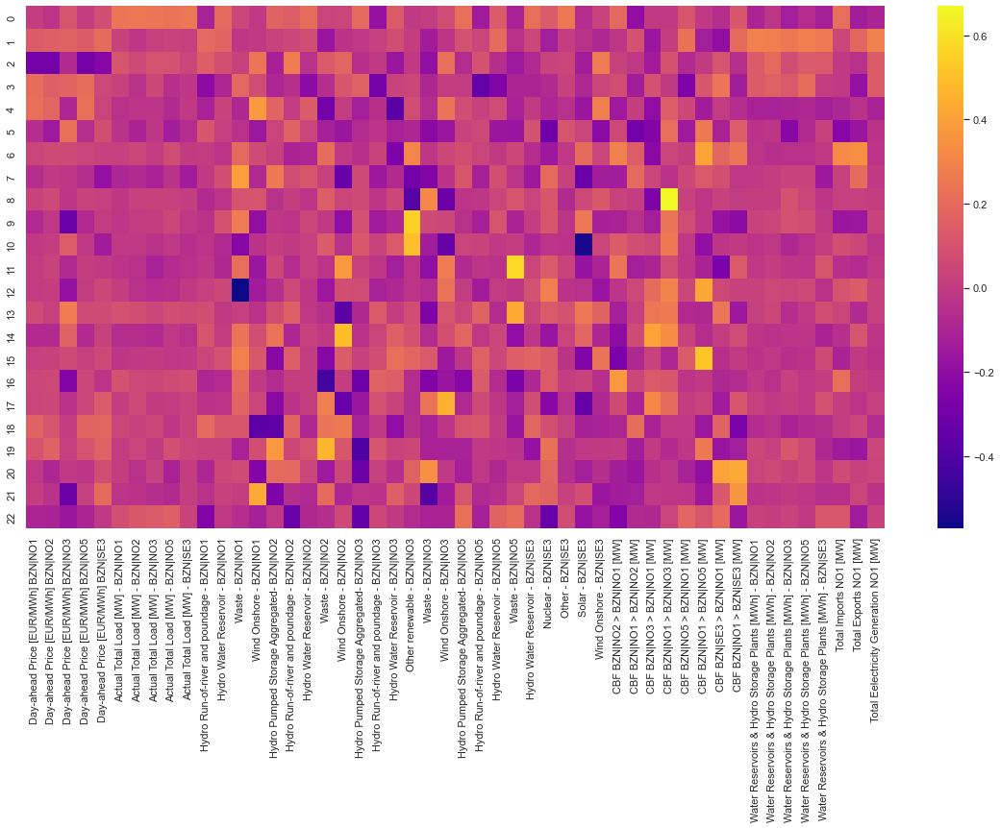

In [361]:
# We create a heatmap that shows the correlation between various features and the principal components
# Each row below represents each principal component
plt.figure(figsize = (20,10))
sns.heatmap (df_comp , cmap = 'plasma')

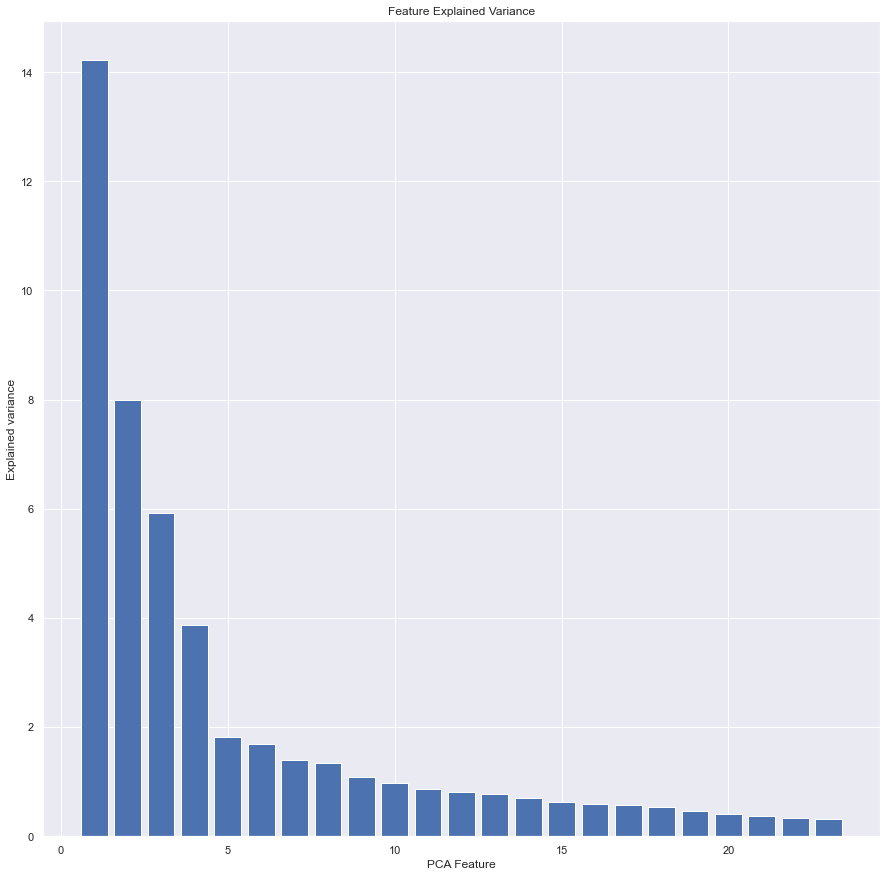

In [362]:
# Bar plot of explained_variance
plt.figure(figsize=(15, 15))
plt.bar(
    range(1,len(pca.explained_variance_)+1),
    pca.explained_variance_
)

plt.xlabel('PCA Feature')
plt.ylabel('Explained variance')
plt.title('Feature Explained Variance')
plt.show()

### Splitting Data

### Handling missing values